In [1]:
## Fundamentals of Libraries ####

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import re

from google.cloud import bigquery
from google.oauth2 import service_account
import pandas_gbq
from pandas_gbq import read_gbq
from google.cloud import secretmanager
import json
import patsy
import datetime

#Statistic
import statsmodels.api as sm
import statsmodels.formula.api as smf

## Modeling

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression, Lasso, Ridge
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler
from joblib import dump,load
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_score

import xgboost as xgb
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import PolynomialFeatures

## MLflow
import mlflow
import mlflow.sklearn

## Dummy changes


In [2]:
##Get Secret File From Secret Manager GCP
def access_secret_version(project_id, secret_id, version_id="1"):
    client = secretmanager.SecretManagerServiceClient()
    name = f"projects/{project_id}/secrets/{secret_id}/versions/{version_id}"
    response = client.access_secret_version(name=name)
    payload = response.payload.data.decode("UTF-8")
    return payload

In [3]:
project_id = "psychic-root-424207-s9"
secret_id = "myfirstproject02_secretman"
table_id  = 'psychic-root-424207-s9.df.df1'

In [4]:
secret_payload = access_secret_version(project_id, secret_id)
gcp_credentials = json.loads(secret_payload)

In [5]:
credentials = service_account.Credentials.from_service_account_info(gcp_credentials)

In [6]:
customer = pd.read_excel("CustomersData.xlsx")
customer

,CustomerID,Gender,Location,Tenure_Months
0,17850,M,Chicago,12
1,13047,M,California,43
2,12583,M,Chicago,33
3,13748,F,California,30
4,15100,M,California,49
...,...,...,...,...
1463,14438,F,New York,41
1464,12956,F,Chicago,48
1465,15781,M,New Jersey,19
1466,14410,F,New York,45


In [7]:
customer.CustomerID.nunique()

1468

In [8]:
discount = pd.read_csv("Discount_Coupon.csv")
discount['Date_month'] = pd.to_datetime(discount['Month'], format='%b').dt.month
discount

,Month,Product_Category,Coupon_Code,Discount_pct,Date_month
0,Jan,Apparel,SALE10,10,1
1,Feb,Apparel,SALE20,20,2
2,Mar,Apparel,SALE30,30,3
3,Jan,Nest-USA,ELEC10,10,1
4,Feb,Nest-USA,ELEC20,20,2
...,...,...,...,...,...
199,Nov,Notebooks & Journals,NJ20,20,11
200,Dec,Notebooks & Journals,NJ30,30,12
201,Oct,Android,AND10,10,10
202,Nov,Android,AND20,20,11


In [9]:
sales = pd.read_csv("Online_Sales.csv")
sales['Transaction_Date'] = pd.to_datetime(sales['Transaction_Date'])
sales['Date_month'] = sales['Transaction_Date'].dt.month  
sales

,CustomerID,Transaction_ID,Transaction_Date,Product_SKU,Product_Description,Product_Category,Quantity,Avg_Price,Delivery_Charges,Coupon_Status,Date_month
0,17850,16679,2019-01-01,GGOENEBJ079499,Nest Learning Thermostat 3rd Gen-USA - Stainle...,Nest-USA,1,153.71,6.50,Used,1
1,17850,16680,2019-01-01,GGOENEBJ079499,Nest Learning Thermostat 3rd Gen-USA - Stainle...,Nest-USA,1,153.71,6.50,Used,1
2,17850,16681,2019-01-01,GGOEGFKQ020399,Google Laptop and Cell Phone Stickers,Office,1,2.05,6.50,Used,1
3,17850,16682,2019-01-01,GGOEGAAB010516,Google Men's 100% Cotton Short Sleeve Hero Tee...,Apparel,5,17.53,6.50,Not Used,1
4,17850,16682,2019-01-01,GGOEGBJL013999,Google Canvas Tote Natural/Navy,Bags,1,16.50,6.50,Used,1
...,...,...,...,...,...,...,...,...,...,...,...
52919,14410,48493,2019-12-31,GGOENEBB078899,Nest Cam Indoor Security Camera - USA,Nest-USA,1,121.30,6.50,Clicked,12
52920,14410,48494,2019-12-31,GGOEGAEB091117,Google Zip Hoodie Black,Apparel,1,48.92,6.50,Used,12
52921,14410,48495,2019-12-31,GGOENEBQ084699,Nest Learning Thermostat 3rd Gen-USA - White,Nest-USA,1,151.88,6.50,Used,12
52922,14600,48496,2019-12-31,GGOENEBQ079199,Nest Protect Smoke + CO White Wired Alarm-USA,Nest-USA,5,80.52,6.50,Clicked,12


In [10]:
sales.Product_Category.unique()

array(['Nest-USA', 'Office', 'Apparel', 'Bags', 'Drinkware', 'Lifestyle',
       'Notebooks & Journals', 'Headgear', 'Waze', 'Fun', 'Nest-Canada',
       'Backpacks', 'Google', 'Bottles', 'Gift Cards', 'More Bags',
       'Housewares', 'Android', 'Accessories', 'Nest'], dtype=object)

In [11]:
sales.CustomerID.nunique()

1468

In [12]:
spend = pd.read_csv("Marketing_Spend.csv")
spend['Date'] = pd.to_datetime(spend['Date'])
spend

,Date,Offline_Spend,Online_Spend
0,2019-01-01,4500,2424.50
1,2019-01-02,4500,3480.36
2,2019-01-03,4500,1576.38
3,2019-01-04,4500,2928.55
4,2019-01-05,4500,4055.30
...,...,...,...
360,2019-12-27,4000,3396.87
361,2019-12-28,4000,3246.84
362,2019-12-29,4000,2546.58
363,2019-12-30,4000,674.31


In [13]:
tax = pd.read_excel("Tax_amount.xlsx")
tax

,Product_Category,GST
0,Nest-USA,0.10
1,Office,0.10
2,Apparel,0.18
3,Bags,0.18
4,Drinkware,0.18
5,Lifestyle,0.18
6,Notebooks & Journals,0.05
7,Headgear,0.05
8,Waze,0.18
9,Fun,0.18


In [14]:
sales_cus = pd.merge(sales,customer, on=['CustomerID'], how = 'left')
sales_cus.head(5)

,CustomerID,Transaction_ID,Transaction_Date,Product_SKU,Product_Description,Product_Category,Quantity,Avg_Price,Delivery_Charges,Coupon_Status,Date_month,Gender,Location,Tenure_Months
0,17850,16679,2019-01-01,GGOENEBJ079499,Nest Learning Thermostat 3rd Gen-USA - Stainle...,Nest-USA,1,153.71,6.5,Used,1,M,Chicago,12
1,17850,16680,2019-01-01,GGOENEBJ079499,Nest Learning Thermostat 3rd Gen-USA - Stainle...,Nest-USA,1,153.71,6.5,Used,1,M,Chicago,12
2,17850,16681,2019-01-01,GGOEGFKQ020399,Google Laptop and Cell Phone Stickers,Office,1,2.05,6.5,Used,1,M,Chicago,12
3,17850,16682,2019-01-01,GGOEGAAB010516,Google Men's 100% Cotton Short Sleeve Hero Tee...,Apparel,5,17.53,6.5,Not Used,1,M,Chicago,12
4,17850,16682,2019-01-01,GGOEGBJL013999,Google Canvas Tote Natural/Navy,Bags,1,16.50,6.5,Used,1,M,Chicago,12


In [15]:
sales_cus_dis = pd.merge(sales_cus,discount, on = ['Product_Category', 'Date_month'], how ='left')
sales_cus_dis.rename(columns = {'Transaction_Date': 'Date'}, inplace=True)
sales_cus_dis.head(5)

,CustomerID,Transaction_ID,Date,Product_SKU,Product_Description,Product_Category,Quantity,Avg_Price,Delivery_Charges,Coupon_Status,Date_month,Gender,Location,Tenure_Months,Month,Coupon_Code,Discount_pct
0,17850,16679,2019-01-01,GGOENEBJ079499,Nest Learning Thermostat 3rd Gen-USA - Stainle...,Nest-USA,1,153.71,6.5,Used,1,M,Chicago,12,Jan,ELEC10,10.0
1,17850,16680,2019-01-01,GGOENEBJ079499,Nest Learning Thermostat 3rd Gen-USA - Stainle...,Nest-USA,1,153.71,6.5,Used,1,M,Chicago,12,Jan,ELEC10,10.0
2,17850,16681,2019-01-01,GGOEGFKQ020399,Google Laptop and Cell Phone Stickers,Office,1,2.05,6.5,Used,1,M,Chicago,12,Jan,OFF10,10.0
3,17850,16682,2019-01-01,GGOEGAAB010516,Google Men's 100% Cotton Short Sleeve Hero Tee...,Apparel,5,17.53,6.5,Not Used,1,M,Chicago,12,Jan,SALE10,10.0
4,17850,16682,2019-01-01,GGOEGBJL013999,Google Canvas Tote Natural/Navy,Bags,1,16.50,6.5,Used,1,M,Chicago,12,Jan,AIO10,10.0


In [16]:
df = pd.merge(sales_cus_dis, tax, on = ['Product_Category'], how= 'left')
df['Discount_pct'] = df.apply(lambda row : row['Discount_pct']/100 if row['Coupon_Status'] == 'Used' else 0, axis=1)
pd.set_option('display.max_columns', None)
df['CustomerID'] = df['CustomerID'].astype(str)
df['Transaction_ID'] = df['Transaction_ID'].astype(str)
df.head(5)

,CustomerID,Transaction_ID,Date,Product_SKU,Product_Description,Product_Category,Quantity,Avg_Price,Delivery_Charges,Coupon_Status,Date_month,Gender,Location,Tenure_Months,Month,Coupon_Code,Discount_pct,GST
0,17850,16679,2019-01-01,GGOENEBJ079499,Nest Learning Thermostat 3rd Gen-USA - Stainle...,Nest-USA,1,153.71,6.5,Used,1,M,Chicago,12,Jan,ELEC10,0.1,0.10
1,17850,16680,2019-01-01,GGOENEBJ079499,Nest Learning Thermostat 3rd Gen-USA - Stainle...,Nest-USA,1,153.71,6.5,Used,1,M,Chicago,12,Jan,ELEC10,0.1,0.10
2,17850,16681,2019-01-01,GGOEGFKQ020399,Google Laptop and Cell Phone Stickers,Office,1,2.05,6.5,Used,1,M,Chicago,12,Jan,OFF10,0.1,0.10
3,17850,16682,2019-01-01,GGOEGAAB010516,Google Men's 100% Cotton Short Sleeve Hero Tee...,Apparel,5,17.53,6.5,Not Used,1,M,Chicago,12,Jan,SALE10,0.0,0.18
4,17850,16682,2019-01-01,GGOEGBJL013999,Google Canvas Tote Natural/Navy,Bags,1,16.50,6.5,Used,1,M,Chicago,12,Jan,AIO10,0.1,0.18


In [17]:
df['net_purchase'] = (df['Avg_Price']- (df['Avg_Price']*df['Discount_pct']) - (df['Avg_Price']*df['GST']))* (df['Quantity']) - (df['Delivery_Charges'])

In [18]:
df.head(5)

,CustomerID,Transaction_ID,Date,Product_SKU,Product_Description,Product_Category,Quantity,Avg_Price,Delivery_Charges,Coupon_Status,Date_month,Gender,Location,Tenure_Months,Month,Coupon_Code,Discount_pct,GST,net_purchase
0,17850,16679,2019-01-01,GGOENEBJ079499,Nest Learning Thermostat 3rd Gen-USA - Stainle...,Nest-USA,1,153.71,6.5,Used,1,M,Chicago,12,Jan,ELEC10,0.1,0.10,116.468
1,17850,16680,2019-01-01,GGOENEBJ079499,Nest Learning Thermostat 3rd Gen-USA - Stainle...,Nest-USA,1,153.71,6.5,Used,1,M,Chicago,12,Jan,ELEC10,0.1,0.10,116.468
2,17850,16681,2019-01-01,GGOEGFKQ020399,Google Laptop and Cell Phone Stickers,Office,1,2.05,6.5,Used,1,M,Chicago,12,Jan,OFF10,0.1,0.10,-4.860
3,17850,16682,2019-01-01,GGOEGAAB010516,Google Men's 100% Cotton Short Sleeve Hero Tee...,Apparel,5,17.53,6.5,Not Used,1,M,Chicago,12,Jan,SALE10,0.0,0.18,65.373
4,17850,16682,2019-01-01,GGOEGBJL013999,Google Canvas Tote Natural/Navy,Bags,1,16.50,6.5,Used,1,M,Chicago,12,Jan,AIO10,0.1,0.18,5.380


In [19]:
df[df['CustomerID'] == 17850]['Transaction_ID'].count()

0

In [20]:
sales[sales['CustomerID'] == 17850]['Transaction_ID'].count()

297

In [21]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 52924 entries, 0 to 52923
Data columns (total 19 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   CustomerID           52924 non-null  object        
 1   Transaction_ID       52924 non-null  object        
 2   Date                 52924 non-null  datetime64[ns]
 3   Product_SKU          52924 non-null  object        
 4   Product_Description  52924 non-null  object        
 5   Product_Category     52924 non-null  object        
 6   Quantity             52924 non-null  int64         
 7   Avg_Price            52924 non-null  float64       
 8   Delivery_Charges     52924 non-null  float64       
 9   Coupon_Status        52924 non-null  object        
 10  Date_month           52924 non-null  int32         
 11  Gender               52924 non-null  object        
 12  Location             52924 non-null  object        
 13  Tenure_Months        52924 non-

In [22]:
df.isnull().sum()

CustomerID               0
Transaction_ID           0
Date                     0
Product_SKU              0
Product_Description      0
Product_Category         0
Quantity                 0
Avg_Price                0
Delivery_Charges         0
Coupon_Status            0
Date_month               0
Gender                   0
Location                 0
Tenure_Months            0
Month                  400
Coupon_Code            400
Discount_pct           126
GST                      0
net_purchase           126
dtype: int64

In [23]:
df[df['Discount_pct'].isnull()]

,CustomerID,Transaction_ID,Date,Product_SKU,Product_Description,Product_Category,Quantity,Avg_Price,Delivery_Charges,Coupon_Status,Date_month,Gender,Location,Tenure_Months,Month,Coupon_Code,Discount_pct,GST,net_purchase
62,17850,16704,2019-01-01,GGOEYOBR078599,YouTube Luggage Tag,Fun,4,9.27,6.50,Used,1,M,Chicago,12,NaN,NaN,NaN,0.18,NaN
157,18074,16782,2019-01-02,GGOEGOBC078699,Google Luggage Tag,Fun,1,7.42,6.50,Used,1,F,California,10,NaN,NaN,NaN,0.18,NaN
314,13448,16903,2019-01-03,GGOEGDHG082499,Google 25 oz Clear Stainless Steel Bottle,Google,3,11.54,35.30,Used,1,F,California,41,NaN,NaN,NaN,0.10,NaN
439,14307,16992,2019-01-04,GGOEGBMB073599,Google Collapsible Duffel Black,More Bags,3,22.69,6.50,Used,1,F,California,28,NaN,NaN,NaN,0.18,NaN
648,12838,17142,2019-01-05,GGOEGDHG082499,Google 25 oz Clear Stainless Steel Bottle,Google,2,14.43,6.50,Used,1,F,California,31,NaN,NaN,NaN,0.10,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41974,14368,40516,2019-10-12,GGOEGBRD079699,25L Classic Rucksack,Backpacks,1,79.99,16.85,Used,10,F,New York,4,NaN,NaN,NaN,0.10,NaN
42106,17861,40619,2019-10-13,GGOEGOBC078699,Google Luggage Tag,Fun,2,3.60,6.00,Used,10,F,Chicago,37,NaN,NaN,NaN,0.18,NaN
42401,12935,40805,2019-10-16,GGOEGOBC078699,Google Luggage Tag,Fun,2,3.60,12.99,Used,10,F,New York,23,NaN,NaN,NaN,0.18,NaN
43325,12744,41522,2019-10-24,GGOEGBRD079699,25L Classic Rucksack,Backpacks,1,79.99,6.50,Used,10,M,New York,16,NaN,NaN,NaN,0.10,NaN


In [24]:
df.dropna(inplace=True, axis=0)

In [25]:
df.isnull().sum()

CustomerID             0
Transaction_ID         0
Date                   0
Product_SKU            0
Product_Description    0
Product_Category       0
Quantity               0
Avg_Price              0
Delivery_Charges       0
Coupon_Status          0
Date_month             0
Gender                 0
Location               0
Tenure_Months          0
Month                  0
Coupon_Code            0
Discount_pct           0
GST                    0
net_purchase           0
dtype: int64

In [26]:
df.info()


<class 'pandas.core.frame.DataFrame'>
Index: 52524 entries, 0 to 52923
Data columns (total 19 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   CustomerID           52524 non-null  object        
 1   Transaction_ID       52524 non-null  object        
 2   Date                 52524 non-null  datetime64[ns]
 3   Product_SKU          52524 non-null  object        
 4   Product_Description  52524 non-null  object        
 5   Product_Category     52524 non-null  object        
 6   Quantity             52524 non-null  int64         
 7   Avg_Price            52524 non-null  float64       
 8   Delivery_Charges     52524 non-null  float64       
 9   Coupon_Status        52524 non-null  object        
 10  Date_month           52524 non-null  int32         
 11  Gender               52524 non-null  object        
 12  Location             52524 non-null  object        
 13  Tenure_Months        52524 non-null 

In [27]:
df.describe()

,Date,Quantity,Avg_Price,Delivery_Charges,Date_month,Tenure_Months,Discount_pct,GST,net_purchase
count,52524,52524.000000,52524.000000,52524.000000,52524.000000,52524.000000,52524.000000,52524.000000,52524.000000
mean,2019-07-06 05:10:50.582591232,4.500171,52.429089,10.476922,6.665810,26.140393,0.067527,0.137433,62.285033
min,2019-01-01 00:00:00,1.000000,0.390000,0.000000,1.000000,2.000000,0.000000,0.050000,-484.160000
25%,2019-04-12 00:00:00,1.000000,5.700000,6.000000,4.000000,15.000000,0.000000,0.100000,0.707800
50%,2019-07-14 00:00:00,1.000000,16.990000,6.000000,7.000000,27.000000,0.000000,0.180000,13.499600
75%,2019-09-27 00:00:00,2.000000,119.000000,6.500000,9.000000,37.000000,0.100000,0.180000,100.600000
max,2019-12-31 00:00:00,900.000000,355.740000,521.360000,12.000000,50.000000,0.300000,0.180000,8064.250000
std,NaN,20.159985,64.156649,19.343153,3.335292,13.473500,0.105615,0.045865,138.927374


In [28]:
# Kullanıcının sağladığı DataFrame örneği için medyan, mean, varyans ve standart sapma hesaplanması
summary_stats = df.select_dtypes(include= ['float64', 'int64']).describe().T[['mean', 'std']]
summary_stats['median'] = df.select_dtypes(include= ['float64', 'int64']).median()
summary_stats['variance'] = df.select_dtypes(include= ['float64', 'int64']).var()


summary_stats

,mean,std,median,variance
Quantity,4.500171,20.159985,1.0000,406.424976
Avg_Price,52.429089,64.156649,16.9900,4116.075638
Delivery_Charges,10.476922,19.343153,6.0000,374.157567
Tenure_Months,26.140393,13.473500,27.0000,181.535189
Discount_pct,0.067527,0.105615,0.0000,0.011155
GST,0.137433,0.045865,0.1800,0.002104
net_purchase,62.285033,138.927374,13.4996,19300.815262


In [29]:
df['first_transaction'] = df.groupby('CustomerID')['Date'].transform('min')
df['first_transaction'] = pd.to_datetime(df['first_transaction'])
df.head(5)

,CustomerID,Transaction_ID,Date,Product_SKU,Product_Description,Product_Category,Quantity,Avg_Price,Delivery_Charges,Coupon_Status,Date_month,Gender,Location,Tenure_Months,Month,Coupon_Code,Discount_pct,GST,net_purchase,first_transaction
0,17850,16679,2019-01-01,GGOENEBJ079499,Nest Learning Thermostat 3rd Gen-USA - Stainle...,Nest-USA,1,153.71,6.5,Used,1,M,Chicago,12,Jan,ELEC10,0.1,0.10,116.468,2019-01-01
1,17850,16680,2019-01-01,GGOENEBJ079499,Nest Learning Thermostat 3rd Gen-USA - Stainle...,Nest-USA,1,153.71,6.5,Used,1,M,Chicago,12,Jan,ELEC10,0.1,0.10,116.468,2019-01-01
2,17850,16681,2019-01-01,GGOEGFKQ020399,Google Laptop and Cell Phone Stickers,Office,1,2.05,6.5,Used,1,M,Chicago,12,Jan,OFF10,0.1,0.10,-4.860,2019-01-01
3,17850,16682,2019-01-01,GGOEGAAB010516,Google Men's 100% Cotton Short Sleeve Hero Tee...,Apparel,5,17.53,6.5,Not Used,1,M,Chicago,12,Jan,SALE10,0.0,0.18,65.373,2019-01-01
4,17850,16682,2019-01-01,GGOEGBJL013999,Google Canvas Tote Natural/Navy,Bags,1,16.50,6.5,Used,1,M,Chicago,12,Jan,AIO10,0.1,0.18,5.380,2019-01-01


In [30]:
df["index"] = (df['Date'] - df['first_transaction']).dt.days 
df.head(5)

,CustomerID,Transaction_ID,Date,Product_SKU,Product_Description,Product_Category,Quantity,Avg_Price,Delivery_Charges,Coupon_Status,Date_month,Gender,Location,Tenure_Months,Month,Coupon_Code,Discount_pct,GST,net_purchase,first_transaction,index
0,17850,16679,2019-01-01,GGOENEBJ079499,Nest Learning Thermostat 3rd Gen-USA - Stainle...,Nest-USA,1,153.71,6.5,Used,1,M,Chicago,12,Jan,ELEC10,0.1,0.10,116.468,2019-01-01,0
1,17850,16680,2019-01-01,GGOENEBJ079499,Nest Learning Thermostat 3rd Gen-USA - Stainle...,Nest-USA,1,153.71,6.5,Used,1,M,Chicago,12,Jan,ELEC10,0.1,0.10,116.468,2019-01-01,0
2,17850,16681,2019-01-01,GGOEGFKQ020399,Google Laptop and Cell Phone Stickers,Office,1,2.05,6.5,Used,1,M,Chicago,12,Jan,OFF10,0.1,0.10,-4.860,2019-01-01,0
3,17850,16682,2019-01-01,GGOEGAAB010516,Google Men's 100% Cotton Short Sleeve Hero Tee...,Apparel,5,17.53,6.5,Not Used,1,M,Chicago,12,Jan,SALE10,0.0,0.18,65.373,2019-01-01,0
4,17850,16682,2019-01-01,GGOEGBJL013999,Google Canvas Tote Natural/Navy,Bags,1,16.50,6.5,Used,1,M,Chicago,12,Jan,AIO10,0.1,0.18,5.380,2019-01-01,0


In [31]:
df.head()

,CustomerID,Transaction_ID,Date,Product_SKU,Product_Description,Product_Category,Quantity,Avg_Price,Delivery_Charges,Coupon_Status,Date_month,Gender,Location,Tenure_Months,Month,Coupon_Code,Discount_pct,GST,net_purchase,first_transaction,index
0,17850,16679,2019-01-01,GGOENEBJ079499,Nest Learning Thermostat 3rd Gen-USA - Stainle...,Nest-USA,1,153.71,6.5,Used,1,M,Chicago,12,Jan,ELEC10,0.1,0.10,116.468,2019-01-01,0
1,17850,16680,2019-01-01,GGOENEBJ079499,Nest Learning Thermostat 3rd Gen-USA - Stainle...,Nest-USA,1,153.71,6.5,Used,1,M,Chicago,12,Jan,ELEC10,0.1,0.10,116.468,2019-01-01,0
2,17850,16681,2019-01-01,GGOEGFKQ020399,Google Laptop and Cell Phone Stickers,Office,1,2.05,6.5,Used,1,M,Chicago,12,Jan,OFF10,0.1,0.10,-4.860,2019-01-01,0
3,17850,16682,2019-01-01,GGOEGAAB010516,Google Men's 100% Cotton Short Sleeve Hero Tee...,Apparel,5,17.53,6.5,Not Used,1,M,Chicago,12,Jan,SALE10,0.0,0.18,65.373,2019-01-01,0
4,17850,16682,2019-01-01,GGOEGBJL013999,Google Canvas Tote Natural/Navy,Bags,1,16.50,6.5,Used,1,M,Chicago,12,Jan,AIO10,0.1,0.18,5.380,2019-01-01,0


In [32]:
df.Location.unique()

array(['Chicago', 'California', 'New York', 'New Jersey', 'Washington DC'],
      dtype=object)

In [33]:
pandas_gbq.to_gbq(df, table_id, project_id=project_id, credentials=credentials, if_exists='append')

In [34]:
sql = """
WITH rev as (SELECT 
CustomerID,
DATE(Date) as tDate,
index as date_index,
Gender,
Location,
ROUND(SUM(net_purchase),2) as purchase_rev,


 FROM `psychic-root-424207-s9.df.df1` 
 ---WHERE CustomerID = '17850'
 GROUP BY 1,2,3,4,5
 order by index asc
 )
select *,
ROUND(SUM(purchase_rev) OVER (PARTITION BY CustomerID order by date_index asc),2) as Cum_net_purchase ,
 FROM rev
 GROUP BY 1,2,3,4,5,6

"""

In [35]:
df_query = pandas_gbq.read_gbq(sql, project_id= project_id)

c:\Users\w11\anaconda3\envs\mlflow\Lib\site-packages\google\cloud\bigquery\table.py:2379: UserWarning: A progress bar was requested, but there was an error loading the tqdm library. Please install tqdm to use the progress bar functionality.
  record_batch = self.to_arrow(


In [36]:
df_query[df_query['CustomerID'] == '17850']

,CustomerID,tDate,date_index,Gender,Location,purchase_rev,Cum_net_purchase
2963,17850,2019-01-01,0,M,Chicago,42839.29,42839.29
2964,17850,2019-01-03,2,M,Chicago,9726.79,52566.08
2965,17850,2019-01-04,3,M,Chicago,15639.65,68205.73
2966,17850,2019-01-16,15,M,Chicago,7581.43,75787.16
2967,17850,2019-01-17,16,M,Chicago,46758.90,122546.06
2968,17850,2019-01-18,17,M,Chicago,59000.59,181546.65
2969,17850,2019-01-21,20,M,Chicago,3941.22,185487.87
2970,17850,2019-01-22,21,M,Chicago,49622.48,235110.35
2971,17850,2019-01-24,23,M,Chicago,44881.85,279992.20
2972,17850,2019-01-26,25,M,Chicago,9259.50,289251.70


In [37]:
df_Chicago =  df_query[df_query['Location'] == 'Chicago']
df_California =  df_query[df_query['Location'] == 'California']
df_NY =  df_query[df_query['Location'] == 'New York']
df_NJ =  df_query[df_query['Location'] == 'New Jersey']
df_DC =  df_query[df_query['Location'] == 'Washington DC']

In [38]:
cohort = df_query.groupby(['date_index'])['CustomerID'].nunique().reset_index()
cohort

,date_index,CustomerID
0,0,1468
1,1,219
2,2,12
3,3,6
4,4,4
...,...,...
328,343,1
329,344,2
330,349,2
331,351,3


In [39]:
cohort_pivot = cohort.pivot_table(columns='date_index', values= 'CustomerID')
cohort_pivot

date_index,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,230,232,233,234,235,236,237,238,239,240,241,242,243,244,245,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,271,272,274,275,276,278,279,280,281,282,283,284,286,287,288,289,290,291,292,293,294,296,297,299,300,301,302,304,305,306,307,308,309,310,311,313,314,315,316,317,318,319,320,321,322,323,324,325,327,328,330,331,332,333,334,335,336,337,338,339,340,341,343,344,349,351,358
CustomerID,1468.0,219.0,12.0,6.0,4.0,4.0,7.0,4.0,3.0,4.0,6.0,3.0,4.0,2.0,8.0,8.0,6.0,3.0,3.0,5.0,7.0,5.0,8.0,5.0,5.0,6.0,6.0,5.0,7.0,4.0,6.0,5.0,3.0,4.0,3.0,5.0,5.0,2.0,4.0,2.0,3.0,8.0,12.0,11.0,7.0,2.0,5.0,7.0,4.0,1.0,6.0,8.0,5.0,4.0,4.0,8.0,8.0,4.0,10.0,5.0,5.0,4.0,7.0,8.0,5.0,7.0,4.0,5.0,9.0,7.0,12.0,4.0,6.0,10.0,8.0,8.0,5.0,6.0,6.0,10.0,5.0,5.0,8.0,7.0,4.0,11.0,4.0,7.0,10.0,2.0,7.0,6.0,9.0,8.0,7.0,7.0,6.0,5.0,12.0,2.0,9.0,3.0,2.0,7.0,8.0,3.0,6.0,3.0,4.0,6.0,6.0,10.0,7.0,5.0,8.0,1.0,7.0,3.0,2.0,8.0,6.0,6.0,1.0,6.0,7.0,3.0,8.0,5.0,4.0,7.0,5.0,2.0,5.0,6.0,8.0,4.0,4.0,5.0,4.0,8.0,6.0,13.0,7.0,6.0,6.0,5.0,3.0,6.0,5.0,9.0,3.0,6.0,6.0,8.0,7.0,4.0,7.0,5.0,4.0,4.0,6.0,6.0,7.0,8.0,4.0,3.0,5.0,5.0,6.0,5.0,5.0,9.0,7.0,8.0,7.0,5.0,7.0,7.0,7.0,6.0,4.0,5.0,10.0,7.0,5.0,4.0,6.0,3.0,4.0,4.0,3.0,7.0,3.0,6.0,4.0,6.0,7.0,5.0,4.0,9.0,4.0,2.0,8.0,6.0,4.0,8.0,3.0,3.0,8.0,4.0,3.0,7.0,5.0,2.0,5.0,6.0,8.0,3.0,3.0,2.0,1.0,4.0,6.0,4.0,5.0,2.0,3.0,5.0,1.0,3.0,6.0,4.0,3.0,6.0,4.0,2.0,4.0,3.0,2.0,3.0,4.0,1.0,2.0,4.0,2.0,2.0,3.0,3.0,1.0,1.0,2.0,1.0,2.0,5.0,5.0,3.0,6.0,3.0,5.0,4.0,1.0,2.0,1.0,3.0,2.0,1.0,5.0,1.0,3.0,5.0,1.0,2.0,1.0,3.0,2.0,2.0,1.0,4.0,2.0,2.0,3.0,2.0,2.0,3.0,3.0,1.0,2.0,2.0,2.0,3.0,3.0,4.0,1.0,1.0,1.0,1.0,3.0,3.0,3.0,3.0,1.0,2.0,1.0,1.0,2.0,2.0,3.0,4.0,2.0,2.0,1.0,4.0,3.0,1.0,2.0,1.0,2.0,1.0,4.0,3.0,4.0,1.0,3.0,3.0,1.0,1.0,1.0,1.0,1.0,2.0,2.0,3.0,1.0


In [40]:
cohort_size = cohort_pivot.iloc[:,0]
cohort_size

CustomerID    1468.0
Name: 0, dtype: float64

In [41]:
retention_rate = cohort_pivot.divide(cohort_size, axis=0)
retention_rate

date_index,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,230,232,233,234,235,236,237,238,239,240,241,242,243,244,245,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,271,272,274,275,276,278,279,280,281,282,283,284,286,287,288,289,290,291,292,293,294,296,297,299,300,301,302,304,305,306,307,308,309,310,311,313,314,315,316,317,318,319,320,321,322,323,324,325,327,328,330,331,332,333,334,335,336,337,338,339,340,341,343,344,349,351,358
CustomerID,1.0,0.149183,0.008174,0.004087,0.002725,0.002725,0.004768,0.002725,0.002044,0.002725,0.004087,0.002044,0.002725,0.001362,0.00545,0.00545,0.004087,0.002044,0.002044,0.003406,0.004768,0.003406,0.00545,0.003406,0.003406,0.004087,0.004087,0.003406,0.004768,0.002725,0.004087,0.003406,0.002044,0.002725,0.002044,0.003406,0.003406,0.001362,0.002725,0.001362,0.002044,0.00545,0.008174,0.007493,0.004768,0.001362,0.003406,0.004768,0.002725,0.000681,0.004087,0.00545,0.003406,0.002725,0.002725,0.00545,0.00545,0.002725,0.006812,0.003406,0.003406,0.002725,0.004768,0.00545,0.003406,0.004768,0.002725,0.003406,0.006131,0.004768,0.008174,0.002725,0.004087,0.006812,0.00545,0.00545,0.003406,0.004087,0.004087,0.006812,0.003406,0.003406,0.00545,0.004768,0.002725,0.007493,0.002725,0.004768,0.006812,0.001362,0.004768,0.004087,0.006131,0.00545,0.004768,0.004768,0.004087,0.003406,0.008174,0.001362,0.006131,0.002044,0.001362,0.004768,0.00545,0.002044,0.004087,0.002044,0.002725,0.004087,0.004087,0.006812,0.004768,0.003406,0.00545,0.000681,0.004768,0.002044,0.001362,0.00545,0.004087,0.004087,0.000681,0.004087,0.004768,0.002044,0.00545,0.003406,0.002725,0.004768,0.003406,0.001362,0.003406,0.004087,0.00545,0.002725,0.002725,0.003406,0.002725,0.00545,0.004087,0.008856,0.004768,0.004087,0.004087,0.003406,0.002044,0.004087,0.003406,0.006131,0.002044,0.004087,0.004087,0.00545,0.004768,0.002725,0.004768,0.003406,0.002725,0.002725,0.004087,0.004087,0.004768,0.00545,0.002725,0.002044,0.003406,0.003406,0.004087,0.003406,0.003406,0.006131,0.004768,0.00545,0.004768,0.003406,0.004768,0.004768,0.004768,0.004087,0.002725,0.003406,0.006812,0.004768,0.003406,0.002725,0.004087,0.002044,0.002725,0.002725,0.002044,0.004768,0.002044,0.004087,0.002725,0.004087,0.004768,0.003406,0.002725,0.006131,0.002725,0.001362,0.00545,0.004087,0.002725,0.00545,0.002044,0.002044,0.00545,0.002725,0.002044,0.004768,0.003406,0.001362,0.003406,0.004087,0.00545,0.002044,0.002044,0.001362,0.000681,0.002725,0.004087,0.002725,0.003406,0.001362,0.002044,0.003406,0.000681,0.002044,0.004087,0.002725,0.002044,0.004087,0.002725,0.001362,0.002725,0.002044,0.001362,0.002044,0.002725,0.000681,0.001362,0.002725,0.001362,0.001362,0.002044,0.002044,0.000681,0.000681,0.001362,0.000681,0.001362,0.003406,0.003406,0.002044,0.004087,0.002044,0.003406,0.002725,0.000681,0.001362,0.000681,0.002044,0.001362,0.000681,0.003406,0.000681,0.002044,0.003406,0.000681,0.001362,0.000681,0.002044,0.001362,0.001362,0.000681,0.002725,0.001362,0.001362,0.002044,0.001362,0.001362,0.002044,0.002044,0.000681,0.001362,0.001362,0.001362,0.002044,0.002044,0.002725,0.000681,0.000681,0.000681,0.000681,0.002044,0.002044,0.002044,0.002044,0.000681,0.001362,0.000681,0.000681,0.001362,0.001362,0.002044,0.002725,0.001362,0.001

In [42]:
cohort_rev = df_query.groupby(['date_index'])['Cum_net_purchase'].sum().reset_index()
cohort_rev

,date_index,Cum_net_purchase
0,0,16864462.27
1,1,6665560.14
2,2,462639.70
3,3,419672.50
4,4,14133.82
...,...,...
328,343,33341.07
329,344,391659.40
330,349,466554.87
331,351,731208.88


In [43]:
cohort_pivot_rev = cohort_rev.pivot_table(columns='date_index', values= 'Cum_net_purchase')
cohort_pivot_rev

date_index,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,230,232,233,234,235,236,237,238,239,240,241,242,243,244,245,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,271,272,274,275,276,278,279,280,281,282,283,284,286,287,288,289,290,291,292,293,294,296,297,299,300,301,302,304,305,306,307,308,309,310,311,313,314,315,316,317,318,319,320,321,322,323,324,325,327,328,330,331,332,333,334,335,336,337,338,339,340,341,343,344,349,351,358
Cum_net_purchase,16864462.27,6665560.14,462639.7,419672.5,14133.82,78549.43,205050.84,44126.06,34877.69,143941.63,119179.51,46695.98,18062.57,1195.32,129349.14,228265.71,186600.58,238948.85,36760.17,91661.61,280102.74,309739.67,138167.31,319435.22,132777.01,458326.82,168403.43,77911.94,79317.98,199356.36,101313.9,91041.84,31143.7,57855.41,54856.2,77115.28,221212.54,18898.46,56460.01,12928.01,71081.96,110500.7,368045.45,373692.04,462513.06,131537.37,93552.25,328132.53,253175.82,32128.68,89767.16,168233.76,169435.76,85694.77,46023.21,230718.55,181341.08,222670.61,309270.81,191517.73,139485.71,196968.43,132943.49,179616.75,200910.5,182773.37,20282.05,80564.77,212484.53,325922.74,435407.73,80175.1,217192.87,358352.18,288783.25,340962.07,64211.83,77676.87,81321.95,407815.71,173671.05,135145.4,172907.47,203464.27,64064.57,181933.95,63586.33,550562.0,488725.89,211137.7,201020.87,158440.05,579088.93,419006.3,115541.44,464712.56,131114.35,133647.25,498330.29,46361.97,359720.62,87812.19,71906.09,139157.74,268274.15,48988.99,554406.23,208873.03,403054.44,574244.53,229989.42,763816.85,152486.33,149174.73,207115.5,15476.82,118804.86,34040.15,36395.71,228987.44,49115.42,109480.72,36879.38,149289.86,227811.4,78443.82,174005.63,189096.84,133371.83,225409.16,97809.09,16655.16,165990.39,684256.75,298810.45,184861.76,446535.49,170993.03,40588.94,430170.39,265473.01,1088099.2,241076.84,75602.3,276973.19,192560.29,112680.98,242576.9,166283.23,648119.48,41377.84,199667.02,257338.05,355876.51,284168.52,255119.12,760880.42,675668.09,123730.69,631338.62,170200.33,171035.17,266846.34,315404.52,69117.95,118685.35,123556.68,430712.24,660920.73,230155.35,228504.06,559977.91,749817.79,538699.39,275630.22,226028.64,353522.85,312843.01,417910.03,141740.65,57055.26,169405.63,574812.65,478217.61,126039.83,269029.32,828746.25,842913.96,599266.83,500074.43,72368.85,361211.76,168752.88,382047.72,478117.2,202758.3,212270.13,150369.34,163775.26,1283363.8,296599.53,113029.51,469827.11,201672.18,98452.53,336206.2,192418.89,99889.08,529029.81,364140.64,92088.97,613651.52,442205.8,33069.82,536599.75,199798.71,351539.4,85583.27,227768.24,226847.78,29148.21,369124.22,310094.19,394874.61,215899.6,471919.38,55114.69,199901.58,35831.26,109083.62,229725.06,614498.26,121573.96,289630.24,153737.97,443386.86,172123.57,677153.32,223139.41,155865.27,778981.05,65172.12,32197.63,299611.08,25747.87,78295.58,682179.03,369892.78,239206.87,508461.78,93536.52,244541.7,179372.12,87116.15,521104.52,145012.57,350150.67,251649.48,250796.85,718982.86,171308.54,62065.63,52127.96,61211.18,287661.2,138086.25,231493.39,264893.61,265473.37,958833.01,23776.16,354195.79,47682.8,154554.05,116408.46,61638.33,44863.37,238067.08,50347.08,292117.54,164551.33,53338.62,710013.69,621141.33,487804.

In [44]:
cohort_pivot_rev.iloc[0]


date_index
0      16864462.27
1       6665560.14
2        462639.70
3        419672.50
4         14133.82
          ...     
343       33341.07
344      391659.40
349      466554.87
351      731208.88
358       38717.90
Name: Cum_net_purchase, Length: 333, dtype: float64

In [45]:
average_revenue_per_user = cohort_pivot_rev.iloc[0] / cohort_pivot.iloc[0]
average_revenue_per_user

date_index
0       11488.053317
1       30436.347671
2       38553.308333
3       69945.416667
4        3533.455000
           ...      
343     33341.070000
344    195829.700000
349    233277.435000
351    243736.293333
358     38717.900000
Length: 333, dtype: float64

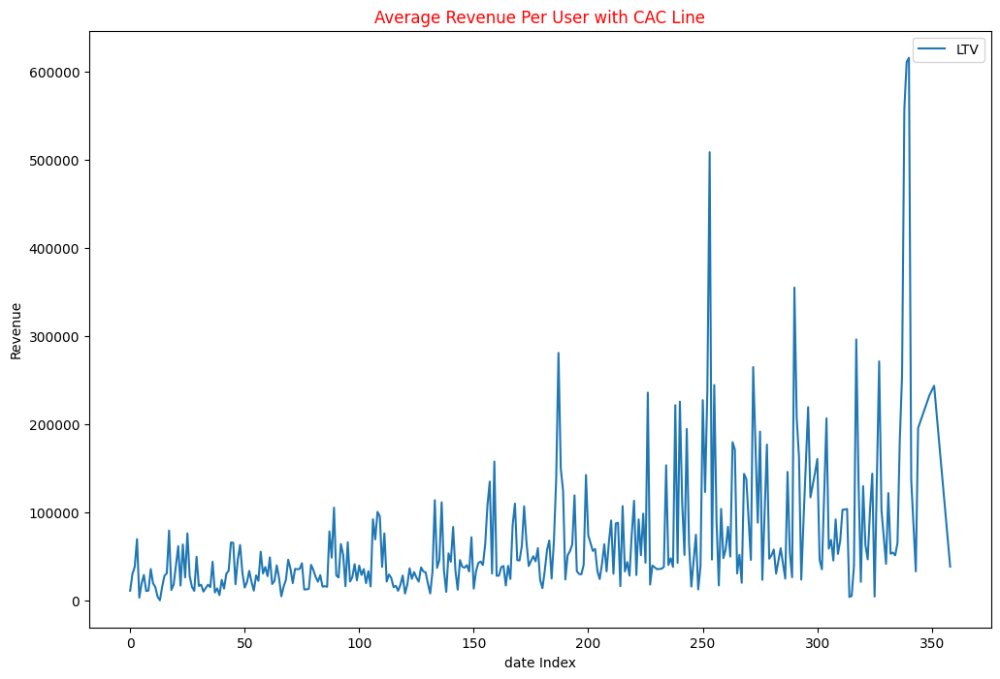

In [46]:
plt.figure(figsize=(12, 8))
average_revenue_per_user.plot(label='LTV')
plt.title('Average Revenue Per User with CAC Line', color = 'r')
plt.xlabel('date Index')
plt.ylabel('Revenue')
plt.legend()

In [47]:
def cal_ltv (df_query):


    cohort = df_query.groupby(['date_index'])['CustomerID'].nunique().reset_index()
    cohort_pivot = cohort.pivot_table(columns='date_index', values= 'CustomerID')
    retention_rate = cohort_pivot.divide(cohort_size, axis=0)

    cohort_rev = df_query.groupby(['date_index'])['Cum_net_purchase'].sum().reset_index()
    cohort_pivot_rev = cohort_rev.pivot_table(columns='date_index', values= 'Cum_net_purchase')
    average_revenue_per_user = cohort_pivot_rev.iloc[0] / cohort_pivot.iloc[0]
    average_revenue_per_user
    plt.figure(figsize=(12, 8))

    # LTV grafiğini çiz
    average_revenue_per_user.plot(label='LTV')



    # Polinom regresyon ile trend çizgisi ekle
    x = np.arange(len(average_revenue_per_user))  # Tarih indeksleri sayısal hale getir
    y = average_revenue_per_user.values  # Gelir değerleri

   
    z = np.polyfit(x, y, 3)
    p = np.poly1d(z)

    # Trend çizgisini grafiğe ekle
    plt.plot(x, p(x), linestyle='-', color='r', label='Trend Line')

    # Başlık ve eksen isimleri
    plt.title('Average Revenue Per User with CAC and Trend Line', color='r')
    plt.xlabel('Date Index')
    plt.ylabel('Revenue')

    # Legend ekle
    plt.legend()

    # Grafiği göster
    plt.show()

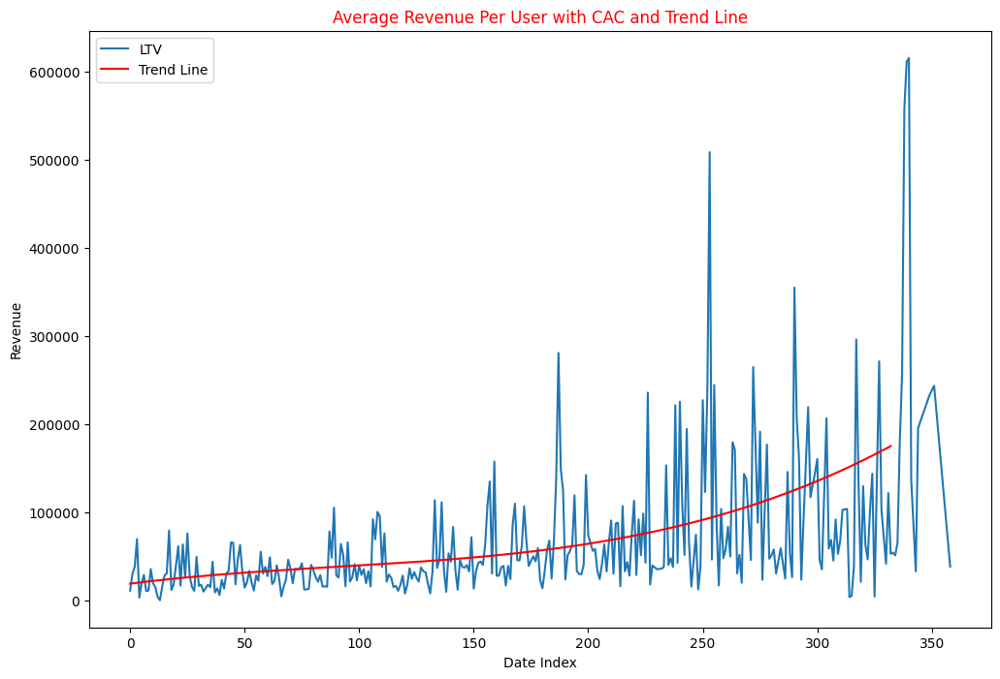

In [48]:
cal_ltv (df_query)

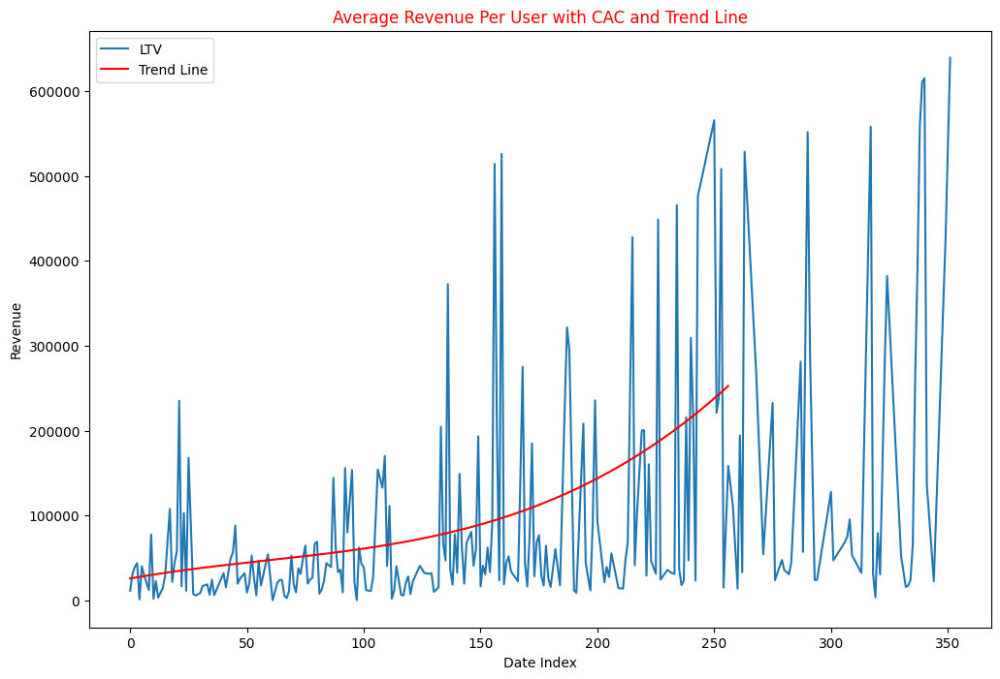

In [49]:
cal_ltv (df_Chicago)

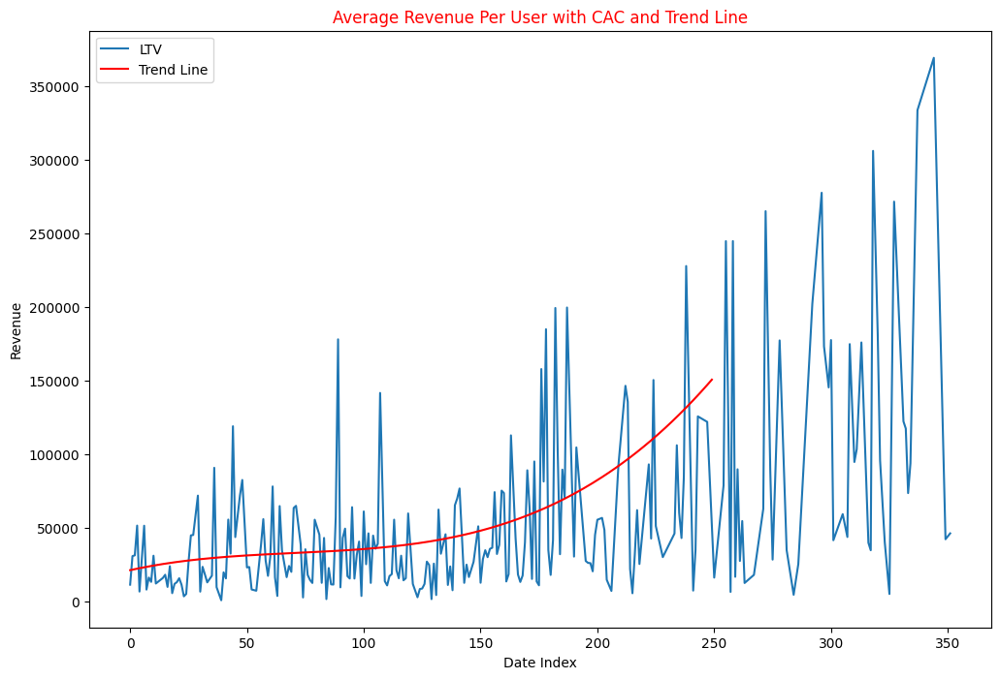

In [50]:
cal_ltv (df_California)

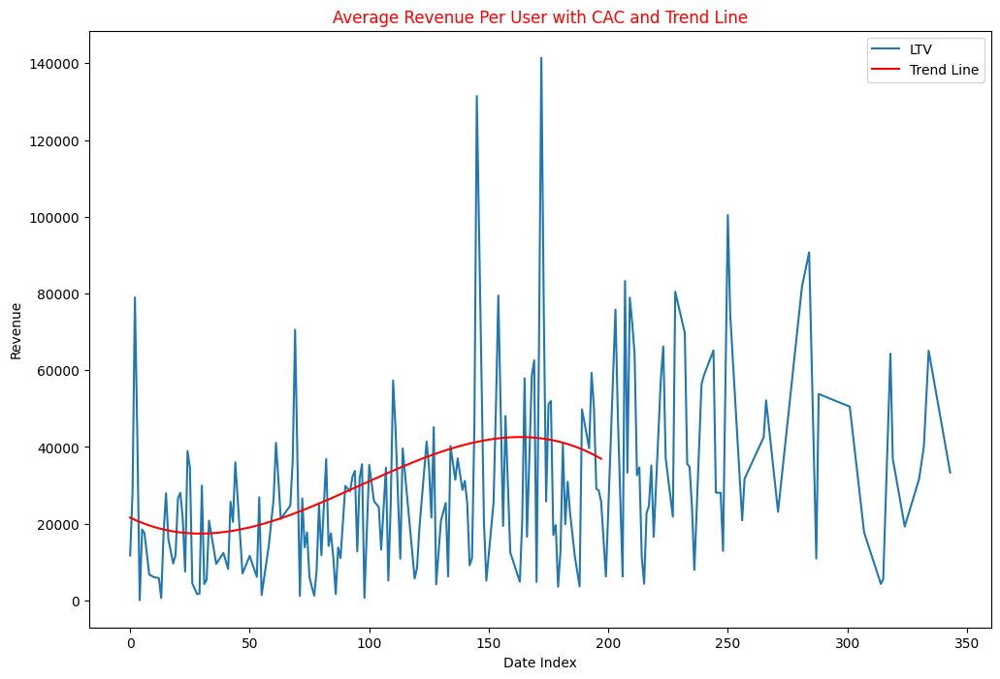

In [51]:
cal_ltv (df_NY)

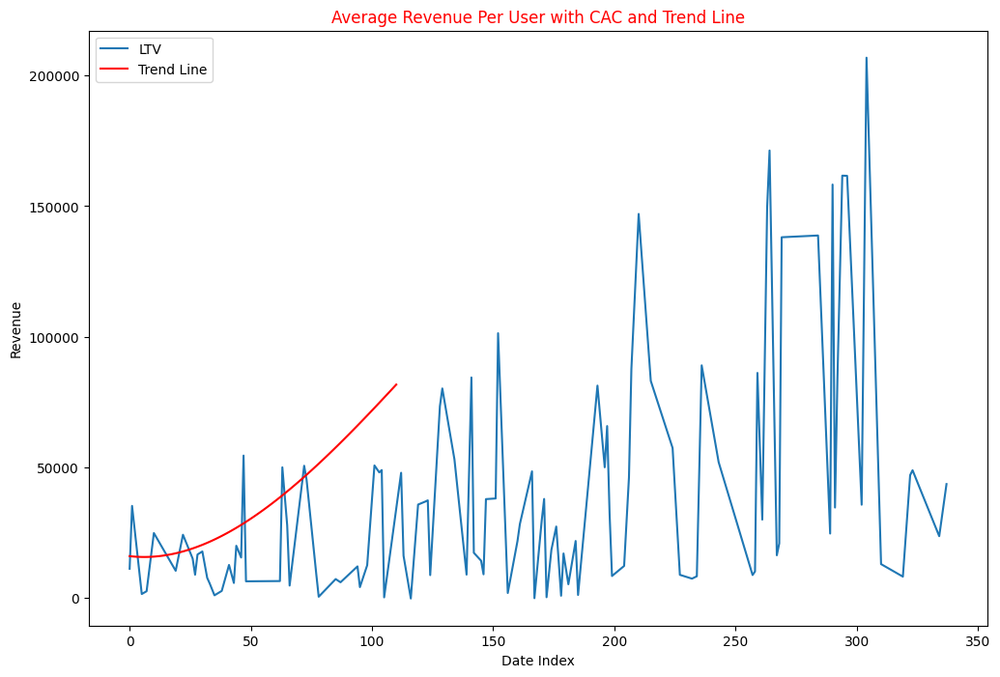

In [52]:
cal_ltv (df_NJ)

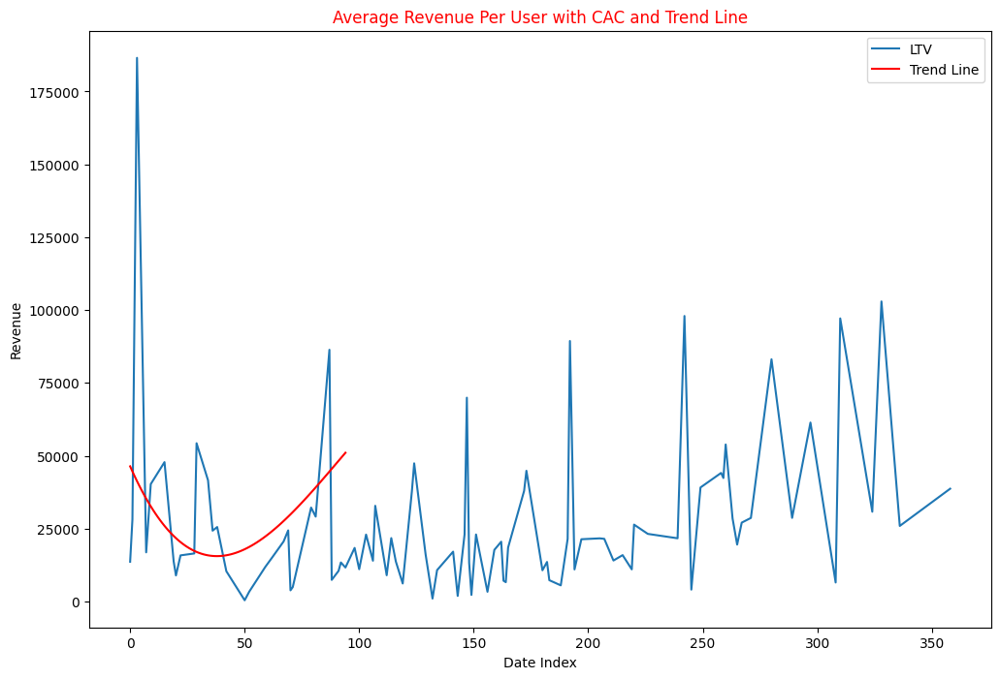

In [53]:
cal_ltv (df_DC)

In [54]:
sql2 = """

WITH rev as (SELECT 
CustomerID,
DATE(Date) as tDate,
index,
Gender,
Location,
ROUND(SUM(net_purchase),2) as purchase_rev,


 FROM `psychic-root-424207-s9.df.df1` 
 ----WHERE CustomerID = '17850'
 GROUP BY 1,2,3,4,5
 order by index asc
 )

SELECT
CustomerID,
Gender,
Location,
MAX(index) as TenureDay,
COUNT(DISTINCT tDate) as transactionDay,
MAX(Cum_net_purchase) as total_rev
FROM
 (
    select *,
    ROUND(SUM(purchase_rev) OVER (PARTITION BY CustomerID order by index asc),2) as Cum_net_purchase ,
    FROM rev
    GROUP BY 1,2,3,4,5,6
 )
 GROUP BY 1,2,3

"""

In [55]:
df_agg = pandas_gbq.read_gbq(sql2, project_id= project_id)

c:\Users\w11\anaconda3\envs\mlflow\Lib\site-packages\google\cloud\bigquery\table.py:2379: UserWarning: A progress bar was requested, but there was an error loading the tqdm library. Please install tqdm to use the progress bar functionality.
  record_batch = self.to_arrow(


In [56]:
df_agg.head(10)

,CustomerID,Gender,Location,TenureDay,transactionDay,total_rev
0,12346,F,New York,0,1,-1463.06
1,12347,M,New York,223,3,113373.30
2,12348,M,California,119,2,10017.30
3,12350,M,California,0,1,10248.80
4,12356,F,Chicago,0,1,4911.19
5,12359,M,New York,0,1,4440.41
6,12370,F,New York,30,2,57324.63
7,12373,F,New York,0,1,3107.19
8,12377,F,California,139,2,86501.88
9,12383,M,New York,72,4,37800.98


In [57]:
df_agg.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1468 entries, 0 to 1467
Data columns (total 6 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   CustomerID      1468 non-null   object 
 1   Gender          1468 non-null   object 
 2   Location        1468 non-null   object 
 3   TenureDay       1468 non-null   Int64  
 4   transactionDay  1468 non-null   Int64  
 5   total_rev       1468 non-null   float64
dtypes: Int64(2), float64(1), object(3)
memory usage: 71.8+ KB


In [58]:

mean = df_agg['total_rev'].mean()
std = df_agg['total_rev'].std()
print(mean)
print(std)

24535.45205040872
40081.42101577159


## Exclude Outliers

In [59]:
df_filtered = df_agg[(df_agg['total_rev'] >= (mean - 3 * std)) & (df_agg['total_rev'] <= (mean + 3 * std))]


In [60]:
df_filtered.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1448 entries, 0 to 1467
Data columns (total 6 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   CustomerID      1448 non-null   object 
 1   Gender          1448 non-null   object 
 2   Location        1448 non-null   object 
 3   TenureDay       1448 non-null   Int64  
 4   transactionDay  1448 non-null   Int64  
 5   total_rev       1448 non-null   float64
dtypes: Int64(2), float64(1), object(3)
memory usage: 82.0+ KB


In [61]:
df_agg = df_agg[df_agg['TenureDay'] >= 90]

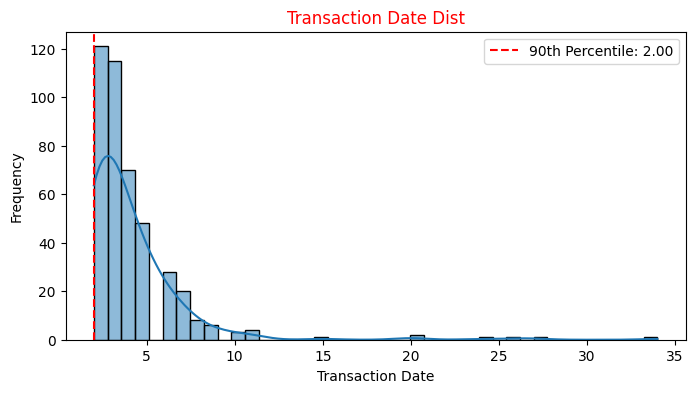

In [62]:
threshold_90 = np.percentile(df_agg['transactionDay'], 10)
plt.figure(figsize=[8,4])
sns.histplot(data=df_agg['transactionDay'], kde=True)
plt.axvline(threshold_90, color='r', linestyle='--', label=f'90th Percentile: {threshold_90:.2f}')
plt.title("Transaction Date Dist", color='r')
plt.xlabel("Transaction Date")
plt.ylabel("Frequency")
plt.legend()
plt.show()

<Axes: xlabel='total_rev', ylabel='Count'>

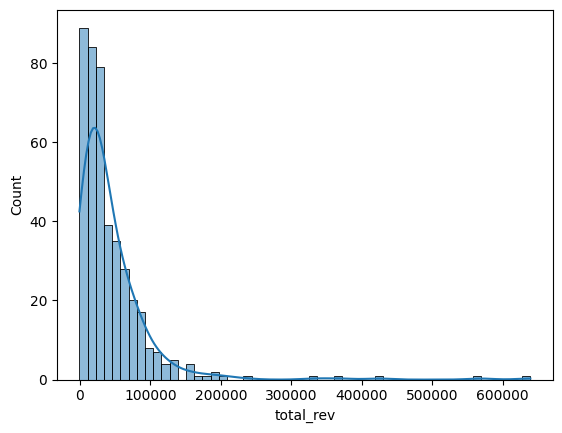

In [63]:
sns.histplot(data=df_agg['total_rev'], kde=True)

In [64]:
df_agg['avg_freq'] = df_agg['TenureDay']/df_agg['transactionDay']

<Axes: xlabel='avg_freq', ylabel='Count'>

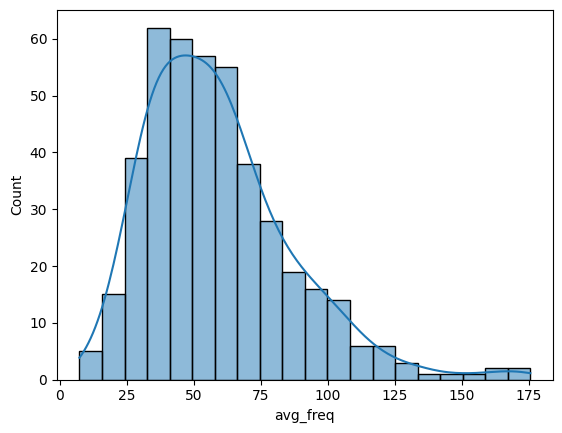

In [65]:
sns.histplot(data=df_agg['avg_freq'], kde=True)

In [66]:
df_agg.describe()

,TenureDay,transactionDay,total_rev,avg_freq
count,430.0,430.0,430.000000,430.0
mean,200.437209,4.123256,44163.161953,59.037544
std,71.887503,3.224494,60268.963723,27.318341
min,90.0,2.0,-457.050000,7.352941
25%,142.0,2.0,12926.287500,38.8
50%,189.5,3.0,28104.275000,54.9
75%,253.25,5.0,56878.752500,71.625
max,358.0,34.0,639222.710000,175.5


In [67]:
# Kullanıcının sağladığı DataFrame örneği için medyan, mean, varyans ve standart sapma hesaplanması
summary_stats = df_agg.select_dtypes(include= ['float64', 'int64']).describe().T[['mean', 'std']]
summary_stats['median'] = df_agg.select_dtypes(include= ['float64', 'int64']).median()
summary_stats['variance'] = df_agg.select_dtypes(include= ['float64', 'int64']).var()
summary_stats

,mean,std,median,variance
TenureDay,200.437209,71.887503,189.5,5167.813064
transactionDay,4.123256,3.224494,3.0,10.39736
total_rev,44163.161953,60268.963723,28104.275,3632347988.235872
avg_freq,59.037544,27.318341,54.9,746.291732


C:\Users\w11\AppData\Local\Temp\ipykernel_19132\1316847427.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data = df_agg, y = 'Gender', x = 'avg_freq', palette = 'pastel')


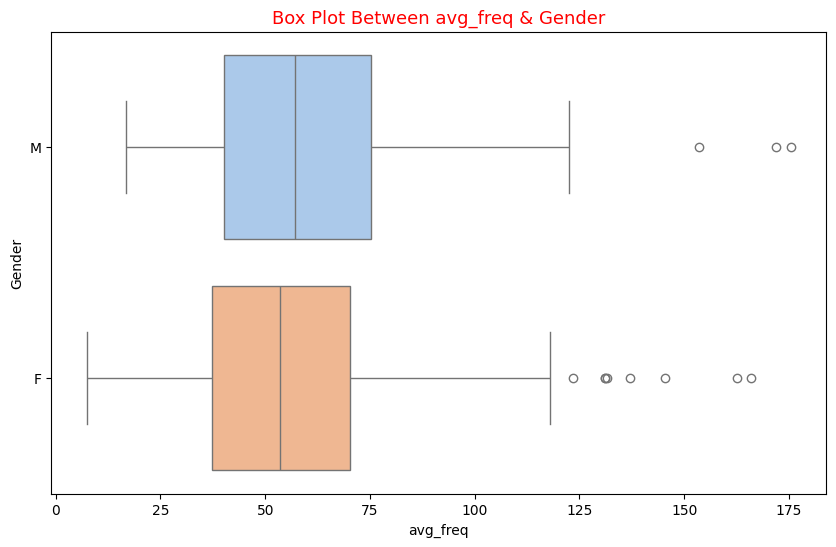

In [68]:
plt.figure(figsize = (10,6))
sns.boxplot(data = df_agg, y = 'Gender', x = 'avg_freq', palette = 'pastel')
plt.title("Box Plot Between avg_freq & Gender", color = 'r', size = 13)
plt.show()

C:\Users\w11\AppData\Local\Temp\ipykernel_19132\1712170892.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data = df_agg, y = 'Location', x = 'avg_freq', palette = 'pastel')


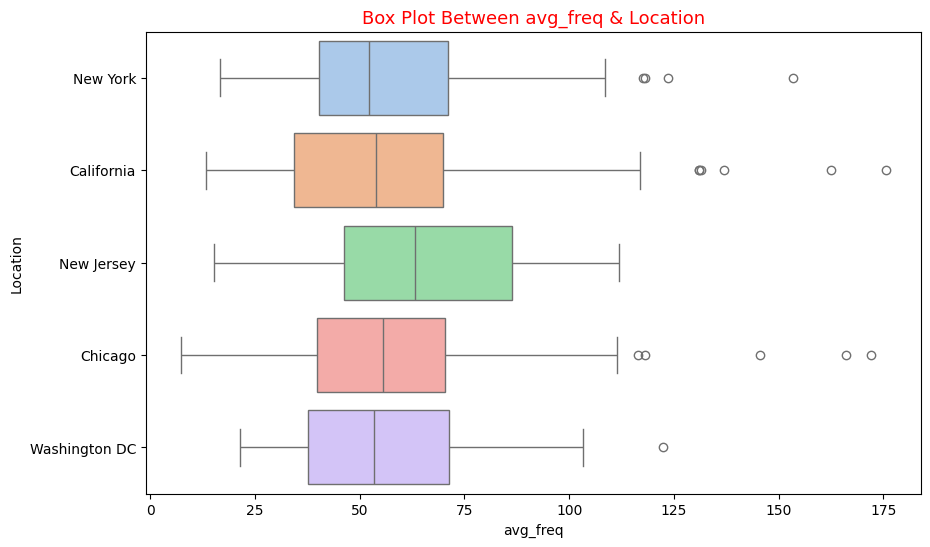

In [69]:
plt.figure(figsize = (10,6))
sns.boxplot(data = df_agg, y = 'Location', x = 'avg_freq', palette = 'pastel')
plt.title("Box Plot Between avg_freq & Location", color = 'r', size = 13)
plt.show()

C:\Users\w11\AppData\Local\Temp\ipykernel_19132\3668836652.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data = df_agg, y = 'Location', x = 'total_rev', palette = 'pastel')


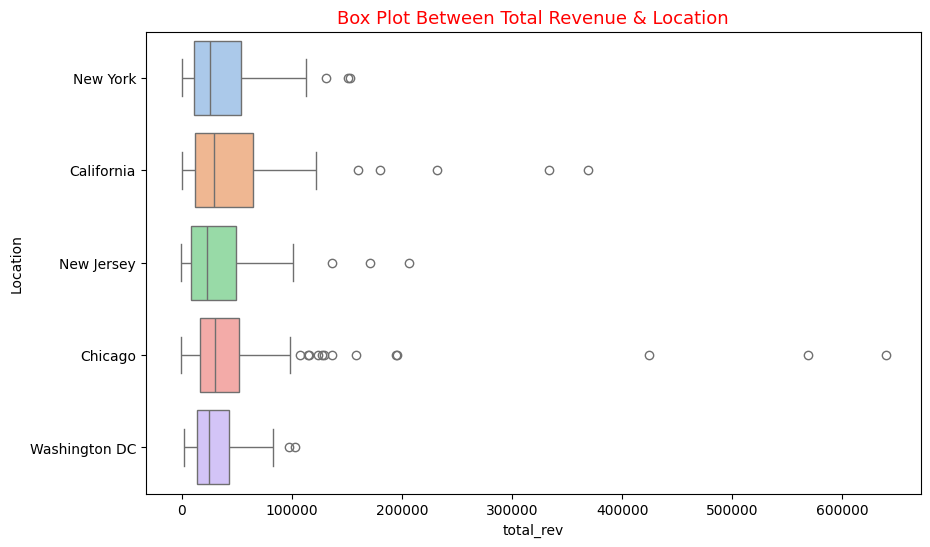

In [70]:
plt.figure(figsize = (10,6))
sns.boxplot(data = df_agg, y = 'Location', x = 'total_rev', palette = 'pastel')
plt.title("Box Plot Between Total Revenue & Location", color = 'r', size = 13)
plt.show()

C:\Users\w11\AppData\Local\Temp\ipykernel_19132\3433513177.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data = df_agg, y = 'Gender', x = 'total_rev', palette = 'pastel')


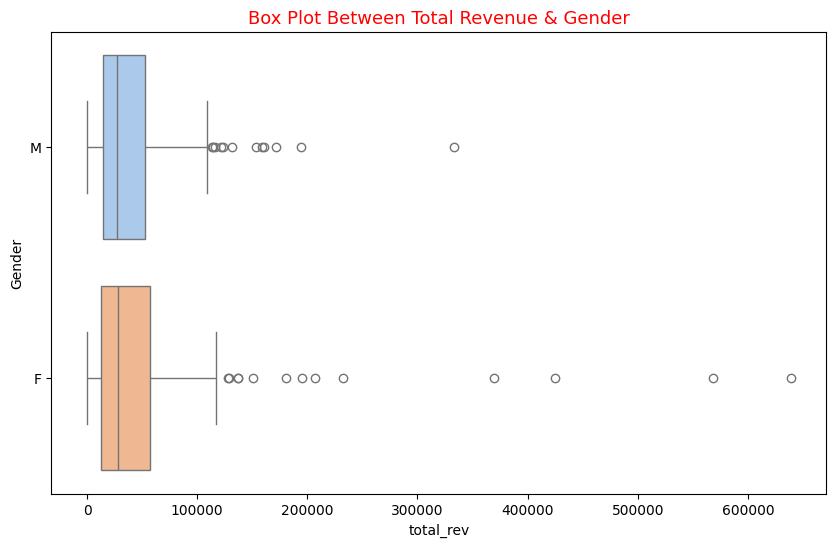

In [71]:
plt.figure(figsize = (10,6))
sns.boxplot(data = df_agg, y = 'Gender', x = 'total_rev', palette = 'pastel')
plt.title("Box Plot Between Total Revenue & Gender", color = 'r', size = 13)
plt.show()

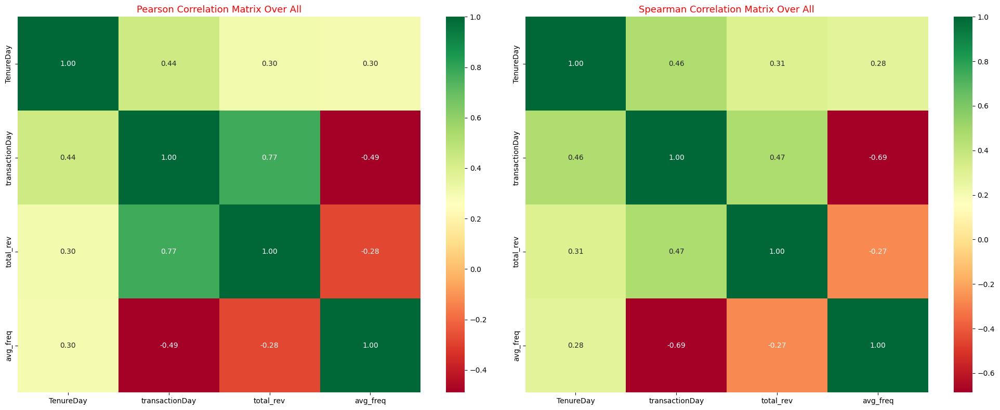

In [72]:
def corr_matrix(df_agg):


    df_agg_num = df_agg.select_dtypes(include= 'number')
    df_agg_num.dropna(inplace=True)

    plt.figure(figsize = (20,8))

    plt.subplot(1,2,1)
    sns.heatmap(df_agg_num.corr(method='pearson'), annot = True, fmt=".2f", cmap='RdYlGn')
    plt.title('Pearson Correlation Matrix Over All', color = 'r', size =13)

    plt.subplot(1,2,2)
    sns.heatmap(df_agg_num.corr(method='spearman'), annot = True, fmt=".2f", cmap='RdYlGn')
    plt.title('Spearman Correlation Matrix Over All', color = 'r', size =13)

    plt.tight_layout()
    plt.show()


corr_matrix(df_agg)

In [73]:
df_agg

,CustomerID,Gender,Location,TenureDay,transactionDay,total_rev,avg_freq
1,12347,M,New York,223,3,113373.30,74.333333
2,12348,M,California,119,2,10017.30,59.5
8,12377,F,California,139,2,86501.88,69.5
10,12386,M,California,123,2,3816.36,61.5
13,12395,F,New Jersey,161,3,9618.24,53.666667
...,...,...,...,...,...,...,...
1453,18223,M,Washington DC,107,5,32856.80,21.4
1456,18229,M,New York,227,3,21815.11,75.666667
1459,18239,M,New York,301,3,50504.43,100.333333
1460,18245,F,Washington DC,147,3,69943.77,49.0


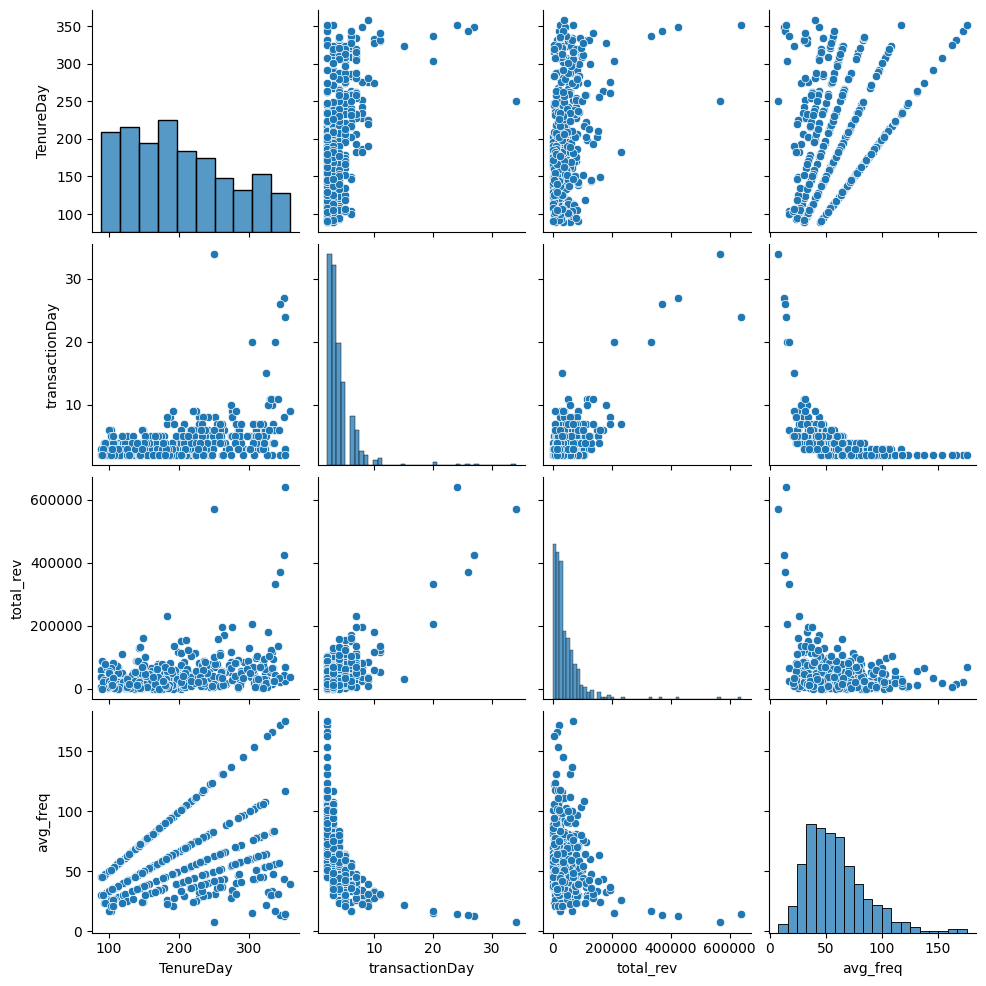

In [74]:
sns.pairplot(df_agg.select_dtypes(include= ['float64', 'int64']))

In [75]:
average = df_agg.groupby(['Location','Gender'])[['total_rev']].mean().reset_index()
average.rename(columns = {'total_rev' : 'total_rev_avg'}, inplace=True)
average

,Location,Gender,total_rev_avg
0,California,F,42369.905366
1,California,M,54437.957556
2,Chicago,F,56143.293765
3,Chicago,M,41963.292308
4,New Jersey,F,46336.283333
5,New Jersey,M,29082.431000
6,New York,F,35607.896786
7,New York,M,38612.817750
8,Washington DC,F,42733.097692
9,Washington DC,M,24926.424615


In [76]:
df_agg2 = pd.merge(df_agg,average , on = ['Location','Gender'], how = 'left')
df_agg2

,CustomerID,Gender,Location,TenureDay,transactionDay,total_rev,avg_freq,total_rev_avg
0,12347,M,New York,223,3,113373.30,74.333333,38612.817750
1,12348,M,California,119,2,10017.30,59.5,54437.957556
2,12377,F,California,139,2,86501.88,69.5,42369.905366
3,12386,M,California,123,2,3816.36,61.5,54437.957556
4,12395,F,New Jersey,161,3,9618.24,53.666667,46336.283333
...,...,...,...,...,...,...,...,...
425,18223,M,Washington DC,107,5,32856.80,21.4,24926.424615
426,18229,M,New York,227,3,21815.11,75.666667,38612.817750
427,18239,M,New York,301,3,50504.43,100.333333,38612.817750
428,18245,F,Washington DC,147,3,69943.77,49.0,42733.097692


In [77]:
df_agg2.head()

,CustomerID,Gender,Location,TenureDay,transactionDay,total_rev,avg_freq,total_rev_avg
0,12347,M,New York,223,3,113373.30,74.333333,38612.817750
1,12348,M,California,119,2,10017.30,59.5,54437.957556
2,12377,F,California,139,2,86501.88,69.5,42369.905366
3,12386,M,California,123,2,3816.36,61.5,54437.957556
4,12395,F,New Jersey,161,3,9618.24,53.666667,46336.283333


In [78]:
print(df_agg2.columns)

Index(['CustomerID', 'Gender', 'Location', 'TenureDay', 'transactionDay',
       'total_rev', 'avg_freq', 'total_rev_avg'],
      dtype='object')


In [79]:
x = df_agg2[['TenureDay', 'transactionDay','avg_freq','total_rev_avg']]
y = df_agg2[['total_rev']]

In [80]:
x

,TenureDay,transactionDay,avg_freq,total_rev_avg
0,223,3,74.333333,38612.817750
1,119,2,59.5,54437.957556
2,139,2,69.5,42369.905366
3,123,2,61.5,54437.957556
4,161,3,53.666667,46336.283333
...,...,...,...,...
425,107,5,21.4,24926.424615
426,227,3,75.666667,38612.817750
427,301,3,100.333333,38612.817750
428,147,3,49.0,42733.097692


In [81]:
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.30, random_state=42)

In [82]:
mlflow.create_experiment("Total Revenue Pred")
mlflow.set_experiment('Prediction of Revenue')

2024/10/18 11:13:35 INFO mlflow.tracking.fluent: Experiment with name 'Prediction of Revenue' does not exist. Creating a new experiment.


<Experiment: artifact_location='file:///c:/Users/w11/Desktop/My%20Projects/eCommerce/mlruns/779345220647912741', creation_time=1729239215557, experiment_id='779345220647912741', last_update_time=1729239215557, lifecycle_stage='active', name='Prediction of Revenue', tags={}>

## Linerar Regression

Test R2 Score: 0.681
Train R² Score: 0.541
Mean Absolute Error: 28502.615
Mean Squared Error: 2107066414.030
Root Mean Squared Error: 45902.793
Cross-Validation R² Scores: [-0.20630782  0.00629089  0.291969    0.72059267  0.38254485  0.19024183
  0.49840488  0.07538085 -1.04900194  0.06087038]
Average Cross-Validation R² Score: 0.097


<Figure size 1200x800 with 0 Axes>

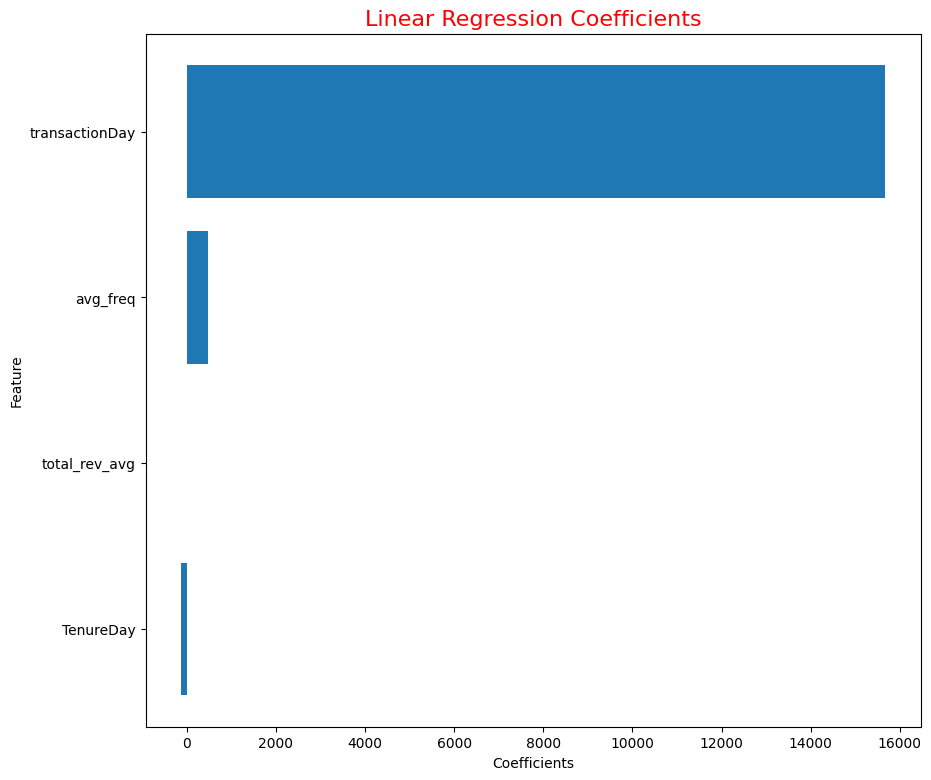

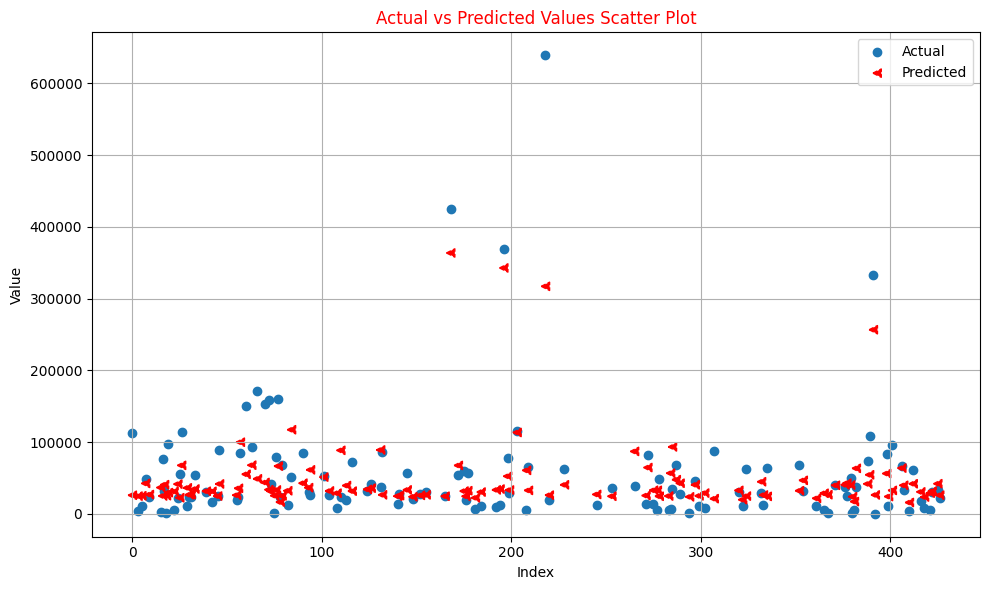

In [85]:
def linear_reg(X_train, y_train):   
    lr_model = LinearRegression()
    lr_model.fit(X_train, y_train)

    test_score = lr_model.score(X_test, y_test)
    y_pred_lr = lr_model.predict(X_test)
    mae = mean_absolute_error(y_test, y_pred_lr)
    mse = mean_squared_error(y_test, y_pred_lr)
    rmse = np.sqrt(mse)
    Train_score = r2_score(y_train, lr_model.predict(X_train))
    cv_scores = cross_val_score(lr_model, X_train, y_train, cv=10, scoring='r2')


    print('Test R2 Score:', round(test_score,3))
    print(f"Train R² Score: {Train_score:.3f}")
    print(f"Mean Absolute Error: {mae:.3f}")
    print(f"Mean Squared Error: {mse:.3f}")
    print(f"Root Mean Squared Error: {rmse:.3f}")
    print(f"Cross-Validation R² Scores: {cv_scores}")
    print(f"Average Cross-Validation R² Score: {np.mean(cv_scores):.3f}")

    plt.figure(figsize=(12, 8))
    coefficients = pd.DataFrame(lr_model.coef_.ravel(), X_train.columns, columns=['Coefficient'])

    # Coefficient'ları sıralayıp görselleştirme
    coefficients = coefficients.sort_values(by='Coefficient', ascending=False)

    plt.figure(figsize=(10, 9))
    plt.barh(coefficients.index, coefficients['Coefficient'])
    plt.xlabel('Coefficients')
    plt.ylabel('Feature')
    plt.title('Linear Regression Coefficients', color='r', size=16)
    plt.gca().invert_yaxis()  # Sort descending
    plt.show()

        # Actual & LR Model Prediction on Scatter Plot
    results = pd.DataFrame(X_test.copy())
    results['Actual'] = y_test
    results['Predicted'] = y_pred_lr

    plt.figure(figsize=(10, 6))
    plt.scatter(results.index, results['Actual'], marker='o', label='Actual')
    plt.scatter(results.index, results['Predicted'], marker='<', linestyle='--', color='r', label='Predicted')

    plt.title('Actual vs Predicted Values Scatter Plot', color = 'r')
    plt.xlabel('Index')
    plt.ylabel('Value')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()

    plt.show()


linear_reg(X_train, y_train)

## Random Forest

In [87]:
def random_forest_reg(X_train, y_train):
    # Model Train
    rf_model = RandomForestRegressor(n_estimators=1000, random_state=42)  
    rf_model.fit(X_train, y_train)

    # prediction
    y_pred_rf = rf_model.predict(X_test)

    # Performace Metric's Calculation
    test_score_rf = r2_score(y_test, y_pred_rf)
    mse_rf = mean_squared_error(y_test, y_pred_rf)
    rmse_rf = np.sqrt(mse_rf)
    R2_Score_cv_rf = cross_val_score(rf_model, x, y , cv = 5, scoring = 'r2')

    print(f"Test R2 Score: {test_score_rf:.3f}")
    print(f"Mean Squared Error: {mse_rf:.3f}")
    print(f"Root Mean Squared Error: {rmse_rf:.3f}")
    print("R2 Scores: ", R2_Score_cv_rf)
    print("Average R2 Scores: ", np.mean(R2_Score_cv_rf))


random_forest_reg(X_train, y_train)

c:\Users\w11\anaconda3\envs\mlflow\Lib\site-packages\sklearn\base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)
c:\Users\w11\anaconda3\envs\mlflow\Lib\site-packages\sklearn\base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)
c:\Users\w11\anaconda3\envs\mlflow\Lib\site-packages\sklearn\base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)
c:\Users\w11\anaconda3\envs\mlflow\Lib\site-packages\sklearn\base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please ch

Test R2 Score: 0.358
Mean Squared Error: 4233903292.020
Root Mean Squared Error: 65068.451
R2 Scores:  [ 0.58058297  0.49920611  0.6652383  -0.48337975  0.47899508]
Average R2 Scores:  0.3481285416448743


### XGBOOST Regressor


In [88]:

def xgb_regressor(X_train, y_train):

    xg_reg = xgb.XGBRegressor(objective='reg:squarederror', colsample_bytree=0.7, learning_rate=0.1,
                            max_depth=10, alpha=2000, n_estimators=2000, booster = 'gblinear' , eval_metric = ['rmse','mae'])

    # Traing Model
    xg_reg.fit(X_train, y_train)

    # GEt prediction
    y_pred_xgb = xg_reg.predict(X_test)

    #  Test & Train Scores
    test_score = r2_score(y_test, y_pred_xgb)
    mae = mean_absolute_error(y_test, y_pred_xgb)
    mse = mean_squared_error(y_test, y_pred_xgb)
    rmse = np.sqrt(mse)
    Train_score = r2_score(y_train, xg_reg.predict(X_train))
    R2_Score_cv_xgb = cross_val_score(xg_reg, x, y , cv = 5, scoring = 'r2')

    print('Test R2 Score:', round(test_score, 3))
    print(f"Train R² Score: {Train_score:.3f}")
    print(f"Mean Absolute Error: {mae:.3f}")
    print(f"Mean Squared Error: {mse:.3f}")
    print(f"Root Mean Squared Error: {rmse:.3f}")
    print("R2 Scores: ", R2_Score_cv_xgb)
    print("Average R2 Scores from cross validation: ", np.mean(R2_Score_cv_xgb))


xgb_regressor(X_train, y_train)

c:\Users\w11\anaconda3\envs\mlflow\Lib\site-packages\xgboost\core.py:158: UserWarning: [11:17:11] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "colsample_bytree", "max_depth" } are not used.

  warnings.warn(smsg, UserWarning)
c:\Users\w11\anaconda3\envs\mlflow\Lib\site-packages\xgboost\core.py:158: UserWarning: [11:17:11] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "colsample_bytree", "max_depth" } are not used.

  warnings.warn(smsg, UserWarning)
c:\Users\w11\anaconda3\envs\mlflow\Lib\site-packages\xgboost\core.py:158: UserWarning: [11:17:12] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "colsample_bytree", "max_depth" } are not used.

  warnings.w

Test R2 Score: 0.671
Train R² Score: 0.540
Mean Absolute Error: 28726.527
Mean Squared Error: 2173316831.761
Root Mean Squared Error: 46618.846
R2 Scores:  [ 0.59305203  0.60066998  0.66785246 -0.23868728  0.60071087]
Average R2 Scores from cross validation:  0.4447196125984192


In [89]:
def polynomal_reg(X_train, y_train):
    # Polinomal özellikler yaratma (dereceyi ayarlayabilirsiniz, örneğin 2 veya 3)
    degree = 1  # 2. dereceden polinom
    poly = PolynomialFeatures(degree)
    X_train_poly = poly.fit_transform(X_train)
    X_test_poly = poly.transform(X_test)

    # Polinomal regresyon modelini oluşturma ve eğitme
    poly_model = LinearRegression()
    poly_model.fit(X_train_poly, y_train)

    # Test skorunu hesaplama
    test_score = poly_model.score(X_test_poly, y_test)
    y_pred_poly = poly_model.predict(X_test_poly)

    # Hata metriklerini hesaplama
    mae = mean_absolute_error(y_test, y_pred_poly)
    mse = mean_squared_error(y_test, y_pred_poly)
    rmse = np.sqrt(mse)

    # Eğitim skoru hesaplama
    Train_score = r2_score(y_train, poly_model.predict(X_train_poly))

    # Cross-validation ile R² skoru hesaplama
    cv_scores = cross_val_score(poly_model, X_train_poly, y_train, cv=10, scoring='r2')

    # Sonuçları yazdırma
    print('Test R2 Score:', round(test_score, 3))
    print(f"Train R² Score: {Train_score:.3f}")
    print(f"Mean Absolute Error: {mae:.3f}")
    print(f"Mean Squared Error: {mse:.3f}")
    print(f"Root Mean Squared Error: {rmse:.3f}")
    print(f"Cross-Validation R² Scores: {cv_scores}")
    print(f"Average Cross-Validation R² Score: {np.mean(cv_scores):.3f}")


polynomal_reg(X_train, y_train)

Test R2 Score: 0.681
Train R² Score: 0.541
Mean Absolute Error: 28502.615
Mean Squared Error: 2107066414.031
Root Mean Squared Error: 45902.793
Cross-Validation R² Scores: [-0.20630782  0.00629089  0.291969    0.72059267  0.38254485  0.19024183
  0.49840488  0.07538085 -1.04900194  0.06087038]
Average Cross-Validation R² Score: 0.097


In [90]:
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.30, random_state=42)

c:\Users\w11\anaconda3\envs\mlflow\Lib\site-packages\sklearn\base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)
c:\Users\w11\anaconda3\envs\mlflow\Lib\site-packages\xgboost\core.py:158: UserWarning: [11:17:15] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "colsample_bytree", "max_depth" } are not used.

  warnings.warn(smsg, UserWarning)


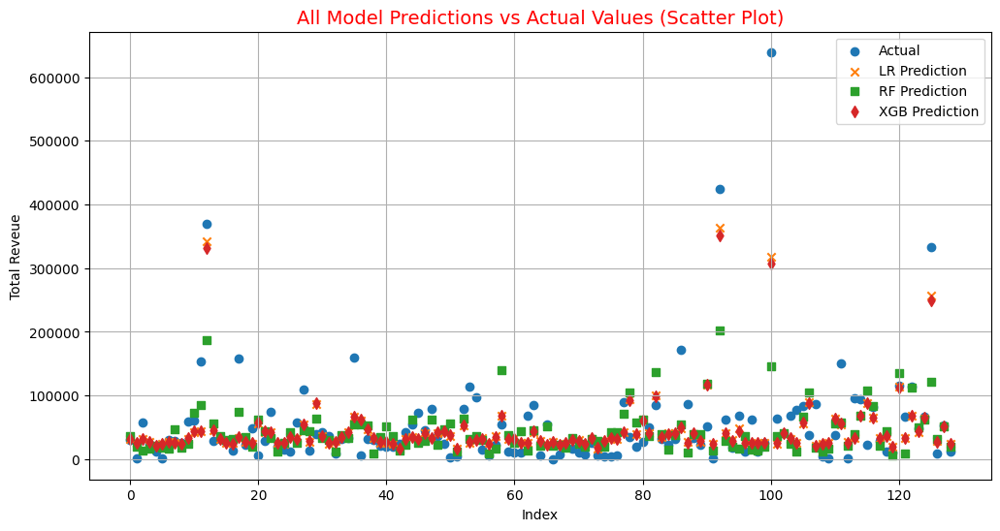

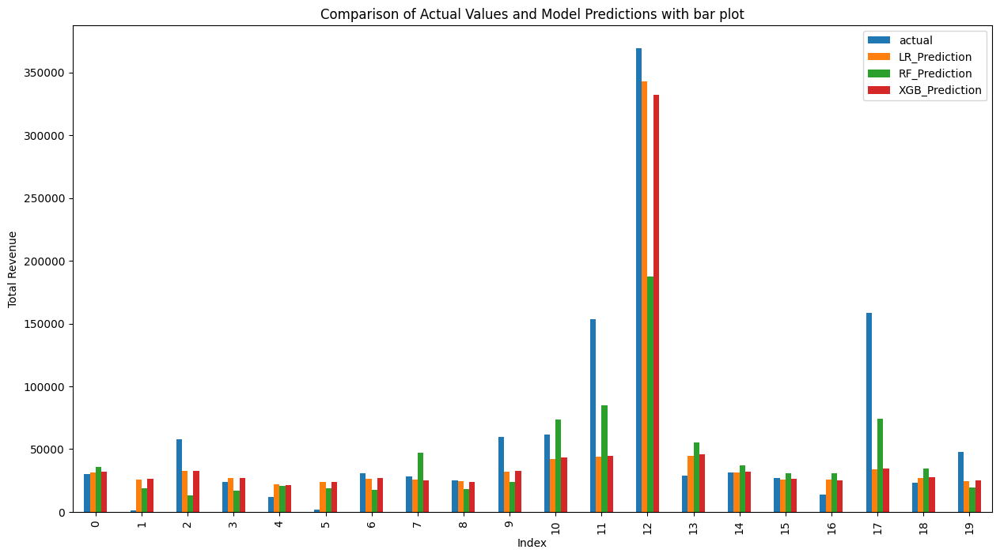

--- All Model Mean predictions-----
actual            54537.642481
LR_Prediction     47278.815910
RF_Prediction     44113.728728
XGB_Prediction    47061.605469
dtype: float64


In [91]:
def combine_pred(X_train, X_test, y_train, y_test):
    lr_model = LinearRegression()
    lr_model.fit(X_train, y_train)


    rf_model = RandomForestRegressor(n_estimators=1500, random_state=42)  
    rf_model.fit(X_train, y_train)


    xg_reg = xgb.XGBRegressor(objective='reg:squarederror', colsample_bytree=0.7, learning_rate=0.1,
                         max_depth=10, alpha=2000, n_estimators=2000, booster = 'gblinear' , eval_metric = ['rmse','mae'])
    xg_reg.fit(X_train, y_train)

    y_pred_lr = lr_model.predict(X_test)
    y_pred_rf = rf_model.predict(X_test)
    y_pred_xgb = xg_reg.predict(X_test)
    df_y_pred_lr = pd.DataFrame(y_pred_lr, columns=['LR_Prediction']).reset_index(drop=True)
    df_y_pred_rf = pd.DataFrame(y_pred_rf, columns=['RF_Prediction']).reset_index(drop=True)
    df_y_pred_xgb = pd.DataFrame(y_pred_xgb, columns=['XGB_Prediction']).reset_index(drop=True)

    y_test.reset_index(inplace=True)
    y_test.drop('index',axis = 1, inplace = True)
    y_test.rename(columns={'total_rev': 'actual'}, inplace=True)

    # Combine All df's
    df_combined = pd.concat([y_test, df_y_pred_lr, df_y_pred_rf, df_y_pred_xgb], axis=1)

    plt.figure(figsize=(12, 6))
    plt.scatter(df_combined.index, df_combined['actual'], label='Actual', marker='o')
    plt.scatter(df_combined.index, df_combined['LR_Prediction'], label='LR Prediction', marker='x')
    plt.scatter(df_combined.index, df_combined['RF_Prediction'], label='RF Prediction', marker='s')
    plt.scatter(df_combined.index, df_combined['XGB_Prediction'], label='XGB Prediction', marker='d')

    
    plt.title('All Model Predictions vs Actual Values (Scatter Plot)', color = 'r', size = 14)
    plt.xlabel('Index')
    plt.ylabel('Total Reveue')
    plt.legend()
    plt.grid(True)
    plt.show()

    df_combined.head(20).plot(kind='bar', figsize=(15, 8))  # İlk 20 satırı göstermek için

    plt.title('Comparison of Actual Values and Model Predictions with bar plot')
    plt.xlabel('Index')
    plt.ylabel('Total Revenue')
    plt.show()

    print("--- All Model Mean predictions-----")
    print(df_combined.mean())


combine_pred(X_train, X_test, y_train, y_test)

## Modeling More Features

In [92]:
sql4 = """ 
WITH rev as (SELECT 
CustomerID,
DATE(Date) as tDate,
index,
Gender,
Location,
ROUND(SUM(net_purchase),2) as purchase_rev,
COUNT(DISTINCT case when Product_Category = 'Bottles' THEN Transaction_ID END) bottles,
COUNT(DISTINCT case when Product_Category = 'Gift Cards' THEN Transaction_ID END) Gift_Cards,
COUNT(DISTINCT case when Product_Category = 'Nest' THEN Transaction_ID END) Nest,
COUNT(DISTINCT case when Product_Category = 'Notebooks & Journals' THEN Transaction_ID END) Notebooks_Journals,
COUNT(DISTINCT case when Product_Category = 'Accessories' THEN Transaction_ID END) Accessories,
COUNT(DISTINCT case when Product_Category = 'Bags' THEN Transaction_ID END) Bags,
COUNT(DISTINCT case when Product_Category = 'Android' THEN Transaction_ID END) 	Android,
COUNT(DISTINCT case when Product_Category = 'Housewares' THEN Transaction_ID END) Housewares,
COUNT(DISTINCT case when Product_Category = 'Office' THEN Transaction_ID END) Office,
COUNT(DISTINCT case when Product_Category = 'Nest-USA' THEN Transaction_ID END) Nest_USA,
COUNT(DISTINCT case when Product_Category = 'Apparel' THEN Transaction_ID END) Apparel,
COUNT(DISTINCT case when Product_Category = 'Waze' THEN Transaction_ID END) Waze,
COUNT(DISTINCT case when Product_Category = 'Drinkware' THEN Transaction_ID END) Drinkware,
COUNT(DISTINCT case when Product_Category = 'Lifestyle' THEN Transaction_ID END) Lifestyle,
COUNT(DISTINCT case when Product_Category = 'Headgear' THEN Transaction_ID END) Headgear,



 FROM `psychic-root-424207-s9.df.df1` 
 ---WHERE CustomerID = '17850'
 GROUP BY 1,2,3,4,5
 order by index asc
 )

SELECT
CustomerID,
Gender,
Location,
MAX(index) as TenureDay,
COUNT(DISTINCT tDate) as transactionDay,
MAX(Cum_net_purchase) as total_rev,
MAX(bottles_sum) bottles_sum,
MAX(Gift_Cards_sum) Gift_Cards_sum,
MAX(Nest_sum) Nest_sum,
MAX(Notebooks_Journals_sum) Notebooks_Journals_sum,
MAX(Accessories_sum) Accessories_sum,
MAX(Bags_sum) Bags_sum,
MAX(Android_sum) Android_sum,
MAX(Housewares_sum) Housewares_sum,
MAX(Office_sum) Office_sum,
MAX(Nest_USA_sum) Nest_USA_sum,
MAX(Apparel_sum) Apparel_sum ,
MAX(Waze_sum) Waze_sum,
MAX(Drinkware_sum) Drinkware_sum,
MAX(Lifestyle_sum) Lifestyle_sum,
MAX(Headgear_sum) Headgear_sum,
COUNT(DISTINCT CASE WHEN bottles != 0 THEN tDate END ) bottles_cnt,
COUNT(DISTINCT CASE WHEN Gift_Cards != 0 THEN tDate END ) Gift_Cards_cnt,
COUNT(DISTINCT CASE WHEN Nest != 0 THEN tDate END ) Nest_cnt,
COUNT(DISTINCT CASE WHEN Notebooks_Journals != 0 THEN tDate END ) Notebooks_Journals_cnt,
COUNT(DISTINCT CASE WHEN Accessories != 0 THEN tDate END ) Accessories_cnt,
COUNT(DISTINCT CASE WHEN Bags != 0 THEN tDate END ) Bags_cnt,
COUNT(DISTINCT CASE WHEN Android != 0 THEN tDate END ) Android_cnt,
COUNT(DISTINCT CASE WHEN Housewares != 0 THEN tDate END ) Housewares_cnt,
COUNT(DISTINCT CASE WHEN Office != 0 THEN tDate END ) Office_cnt,
COUNT(DISTINCT CASE WHEN Nest_USA != 0 THEN tDate END ) Nest_USA_cnt,
COUNT(DISTINCT CASE WHEN Apparel != 0 THEN tDate END ) Apparel_cnt,
COUNT(DISTINCT CASE WHEN Waze != 0 THEN tDate END ) Waze_cnt,
COUNT(DISTINCT CASE WHEN Drinkware != 0 THEN tDate END ) Drinkware_cnt,
COUNT(DISTINCT CASE WHEN Lifestyle != 0 THEN tDate END ) Lifestyle_cnt,
COUNT(DISTINCT CASE WHEN Headgear != 0 THEN tDate END ) Headgear_cnt,
IFNULL (SAFE_DIVIDE (MAX(bottles_sum),COUNT(DISTINCT CASE WHEN bottles != 0 THEN tDate END )),0) as bottleFreq,
IFNULL (SAFE_DIVIDE (MAX(Gift_Cards_sum),COUNT(DISTINCT CASE WHEN Gift_Cards != 0 THEN tDate END )),0) as Gift_CardsFreq,
IFNULL (SAFE_DIVIDE (MAX(Nest_sum),COUNT(DISTINCT CASE WHEN Nest != 0 THEN tDate END )),0) as NestFreq,
IFNULL (SAFE_DIVIDE (MAX(Notebooks_Journals_sum),COUNT(DISTINCT CASE WHEN Notebooks_Journals != 0 THEN tDate END )),0) as Notebooks_JournalsFreq,
IFNULL (SAFE_DIVIDE (MAX(Accessories_sum),COUNT(DISTINCT CASE WHEN Accessories != 0 THEN tDate END )),0) as AccessoriesFreq,
IFNULL (SAFE_DIVIDE (MAX(Bags_sum),COUNT(DISTINCT CASE WHEN Bags != 0 THEN tDate END )),0) as BagsFreq,
IFNULL (SAFE_DIVIDE (MAX(Android_sum),COUNT(DISTINCT CASE WHEN Android != 0 THEN tDate END )),0) as AndroidFreq,
IFNULL (SAFE_DIVIDE (MAX(Housewares_sum),COUNT(DISTINCT CASE WHEN Housewares != 0 THEN tDate END )),0)as HousewaresFreq,
IFNULL (SAFE_DIVIDE (MAX(Office_sum),COUNT(DISTINCT CASE WHEN Office != 0 THEN tDate END )),0) as OfficeFreq,
IFNULL (SAFE_DIVIDE (MAX(Nest_USA_sum),COUNT(DISTINCT CASE WHEN Nest_USA != 0 THEN tDate END )),0) as Nest_USAFreq,
IFNULL (SAFE_DIVIDE (MAX(Apparel_sum),COUNT(DISTINCT CASE WHEN Apparel != 0 THEN tDate END )),0) as ApparelFreq,
IFNULL (SAFE_DIVIDE (MAX(Waze_sum),COUNT(DISTINCT CASE WHEN Waze != 0 THEN tDate END )),0) as WazeFreq,
IFNULL (SAFE_DIVIDE (MAX(Drinkware_sum),COUNT(DISTINCT CASE WHEN Drinkware != 0 THEN tDate END )),0) as DrinkwareFreq,
IFNULL (SAFE_DIVIDE (MAX(Lifestyle_sum),COUNT(DISTINCT CASE WHEN Lifestyle != 0 THEN tDate END )),0) as LifestyleFreq,
IFNULL (SAFE_DIVIDE (MAX(Headgear_sum),COUNT(DISTINCT CASE WHEN Headgear != 0 THEN tDate END )),0) as HeadgearFreq,


FROM
 (
    select *,
           
    ROUND(SUM(purchase_rev) OVER (PARTITION BY CustomerID order by index asc),2) as Cum_net_purchase ,
    SUM(bottles) OVER (PARTITION BY CustomerID order by index asc) bottles_sum,
    SUM(Gift_Cards) OVER (PARTITION BY CustomerID order by index asc) Gift_Cards_sum,
    SUM(Nest) OVER (PARTITION BY CustomerID order by index asc) Nest_sum,
    SUM(Notebooks_Journals) OVER (PARTITION BY CustomerID order by index asc) Notebooks_Journals_sum,
    SUM(Accessories) OVER (PARTITION BY CustomerID order by index asc) Accessories_sum,
    SUM(Bags) OVER (PARTITION BY CustomerID order by index asc) Bags_sum,
    SUM(Android) OVER (PARTITION BY CustomerID order by index asc) Android_sum,
    SUM(Housewares) OVER (PARTITION BY CustomerID order by index asc) Housewares_sum,
    SUM(Office) OVER (PARTITION BY CustomerID order by index asc) Office_sum,
    SUM(Nest_USA) OVER (PARTITION BY CustomerID order by index asc) Nest_USA_sum,
    SUM(Apparel) OVER (PARTITION BY CustomerID order by index asc) Apparel_sum,
    SUM(Waze) OVER (PARTITION BY CustomerID order by index asc) Waze_sum,
    SUM(Drinkware) OVER (PARTITION BY CustomerID order by index asc) Drinkware_sum,
    SUM(Lifestyle) OVER (PARTITION BY CustomerID order by index asc) Lifestyle_sum,
    SUM(Headgear) OVER (PARTITION BY CustomerID order by index asc) Headgear_sum,

    
    FROM rev
    GROUP BY 1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21
 )
 GROUP BY 1,2,3


"""

In [93]:
df_prd = pandas_gbq.read_gbq(sql4, project_id= project_id)
df_prd.head()

c:\Users\w11\anaconda3\envs\mlflow\Lib\site-packages\google\cloud\bigquery\table.py:2379: UserWarning: A progress bar was requested, but there was an error loading the tqdm library. Please install tqdm to use the progress bar functionality.
  record_batch = self.to_arrow(


,CustomerID,Gender,Location,TenureDay,transactionDay,total_rev,bottles_sum,Gift_Cards_sum,Nest_sum,Notebooks_Journals_sum,Accessories_sum,Bags_sum,Android_sum,Housewares_sum,Office_sum,Nest_USA_sum,Apparel_sum,Waze_sum,Drinkware_sum,Lifestyle_sum,Headgear_sum,bottles_cnt,Gift_Cards_cnt,Nest_cnt,Notebooks_Journals_cnt,Accessories_cnt,Bags_cnt,Android_cnt,Housewares_cnt,Office_cnt,Nest_USA_cnt,Apparel_cnt,Waze_cnt,Drinkware_cnt,Lifestyle_cnt,Headgear_cnt,bottleFreq,Gift_CardsFreq,NestFreq,Notebooks_JournalsFreq,AccessoriesFreq,BagsFreq,AndroidFreq,HousewaresFreq,OfficeFreq,Nest_USAFreq,ApparelFreq,WazeFreq,DrinkwareFreq,LifestyleFreq,HeadgearFreq
0,12346,F,New York,0,1,-1463.06,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.000000,0.0,1.000000,0.0,0.0,0.0,0.0
1,12347,M,New York,223,3,113373.30,0,0,2,0,1,2,0,0,7,16,8,0,1,1,1,0,0,1,0,1,1,0,0,3,2,3,0,1,1,1,0.0,0.0,2.0,0.0,1.0,2.0,0.0,0.0,2.333333,8.0,2.666667,0.0,1.0,1.0,1.0
2,12348,M,California,119,2,10017.30,0,0,0,0,0,2,0,0,3,2,3,0,3,1,0,0,0,0,0,0,2,0,0,2,2,2,0,2,1,0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.500000,1.0,1.500000,0.0,1.5,1.0,0.0
3,12350,M,California,0,1,10248.80,0,0,0,0,0,0,0,0,0,5,4,0,0,0,2,0,0,0,0,0,0,0,0,0,1,1,0,0,0,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,5.0,4.000000,0.0,0.0,0.0,2.0
4,12356,F,Chicago,0,1,4911.19,0,0,2,0,0,1,0,0,1,4,6,0,2,1,0,0,0,1,0,0,1,0,0,1,1,1,0,1,1,0,0.0,0.0,2.0,0.0,0.0,1.0,0.0,0.0,1.000000,4.0,6.000000,0.0,2.0,1.0,0.0


## Exclude Outliers

In [94]:
mean_prd = df_prd['total_rev'].mean()
std_prd = df_prd['total_rev'].std()
print(mean)
df_prd = df_prd[(df_prd['total_rev'] >= (mean_prd - 3 * std_prd)) & (df_prd['total_rev'] <= (mean_prd + 3 * std_prd))]


24535.45205040872


In [95]:
df_prd['dummy'] =  np.random.randint(0,100, size = len(df_prd))
df_prd.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1448 entries, 0 to 1467
Data columns (total 52 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   CustomerID              1448 non-null   object 
 1   Gender                  1448 non-null   object 
 2   Location                1448 non-null   object 
 3   TenureDay               1448 non-null   Int64  
 4   transactionDay          1448 non-null   Int64  
 5   total_rev               1448 non-null   float64
 6   bottles_sum             1448 non-null   Int64  
 7   Gift_Cards_sum          1448 non-null   Int64  
 8   Nest_sum                1448 non-null   Int64  
 9   Notebooks_Journals_sum  1448 non-null   Int64  
 10  Accessories_sum         1448 non-null   Int64  
 11  Bags_sum                1448 non-null   Int64  
 12  Android_sum             1448 non-null   Int64  
 13  Housewares_sum          1448 non-null   Int64  
 14  Office_sum              1448 non-null   Int64

<Axes: xlabel='total_rev', ylabel='Count'>

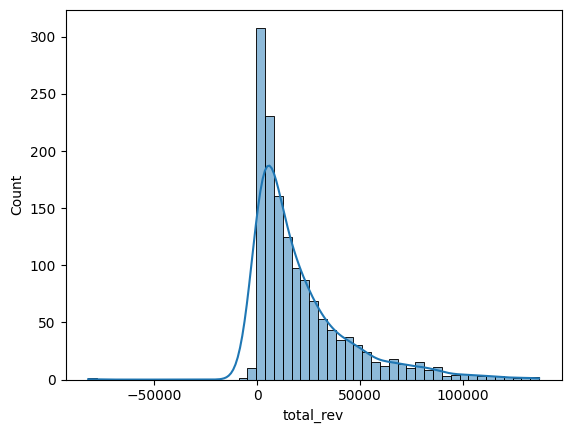

In [96]:
sns.histplot(data=df_prd['total_rev'], kde=True)

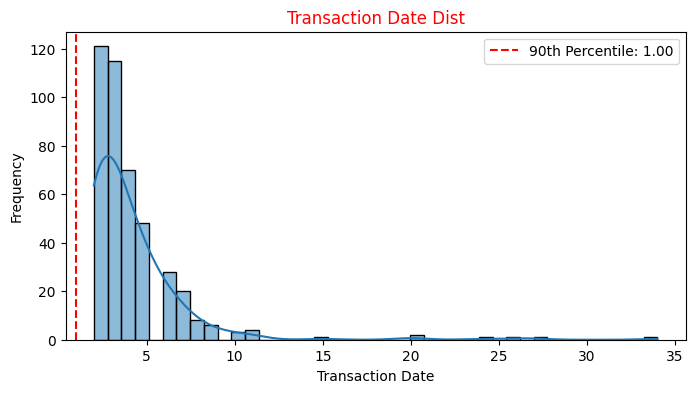

In [97]:
threshold_90 = np.percentile(df_prd['transactionDay'], 10)
plt.figure(figsize=[8,4])
sns.histplot(data=df_agg['transactionDay'], kde=True)
plt.axvline(threshold_90, color='r', linestyle='--', label=f'90th Percentile: {threshold_90:.2f}')
plt.title("Transaction Date Dist", color='r')
plt.xlabel("Transaction Date")
plt.ylabel("Frequency")
plt.legend()
plt.show()

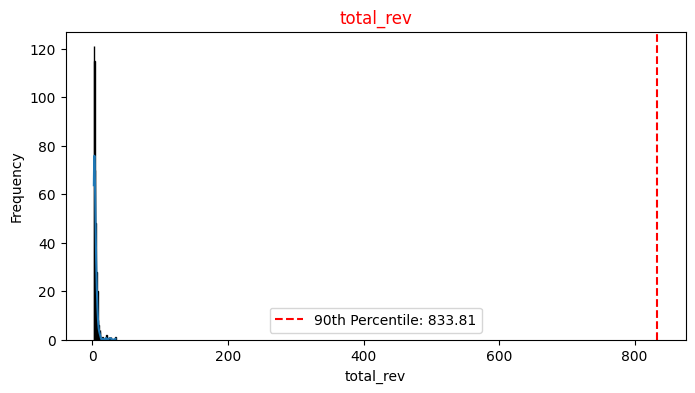

In [98]:
threshold_90 = np.percentile(df_prd['total_rev'], 10)
plt.figure(figsize=[8,4])
sns.histplot(data=df_agg['transactionDay'], kde=True)
plt.axvline(threshold_90, color='r', linestyle='--', label=f'90th Percentile: {threshold_90:.2f}')
plt.title("total_rev", color='r')
plt.xlabel("total_rev")
plt.ylabel("Frequency")
plt.legend()
plt.show()

In [99]:
sns.pairplot(df_prd.select_dtypes(include= ['float64', 'int64']))

In [100]:
df_prd = pd.merge(df_prd,average , on = ['Location','Gender'], how = 'left')
df_prd.head()

,CustomerID,Gender,Location,TenureDay,transactionDay,total_rev,bottles_sum,Gift_Cards_sum,Nest_sum,Notebooks_Journals_sum,Accessories_sum,Bags_sum,Android_sum,Housewares_sum,Office_sum,Nest_USA_sum,Apparel_sum,Waze_sum,Drinkware_sum,Lifestyle_sum,Headgear_sum,bottles_cnt,Gift_Cards_cnt,Nest_cnt,Notebooks_Journals_cnt,Accessories_cnt,Bags_cnt,Android_cnt,Housewares_cnt,Office_cnt,Nest_USA_cnt,Apparel_cnt,Waze_cnt,Drinkware_cnt,Lifestyle_cnt,Headgear_cnt,bottleFreq,Gift_CardsFreq,NestFreq,Notebooks_JournalsFreq,AccessoriesFreq,BagsFreq,AndroidFreq,HousewaresFreq,OfficeFreq,Nest_USAFreq,ApparelFreq,WazeFreq,DrinkwareFreq,LifestyleFreq,HeadgearFreq,dummy,total_rev_avg
0,12346,F,New York,0,1,-1463.06,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.000000,0.0,1.000000,0.0,0.0,0.0,0.0,52,35607.896786
1,12347,M,New York,223,3,113373.30,0,0,2,0,1,2,0,0,7,16,8,0,1,1,1,0,0,1,0,1,1,0,0,3,2,3,0,1,1,1,0.0,0.0,2.0,0.0,1.0,2.0,0.0,0.0,2.333333,8.0,2.666667,0.0,1.0,1.0,1.0,27,38612.817750
2,12348,M,California,119,2,10017.30,0,0,0,0,0,2,0,0,3,2,3,0,3,1,0,0,0,0,0,0,2,0,0,2,2,2,0,2,1,0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.500000,1.0,1.500000,0.0,1.5,1.0,0.0,86,54437.957556
3,12350,M,California,0,1,10248.80,0,0,0,0,0,0,0,0,0,5,4,0,0,0,2,0,0,0,0,0,0,0,0,0,1,1,0,0,0,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,5.0,4.000000,0.0,0.0,0.0,2.0,93,54437.957556
4,12356,F,Chicago,0,1,4911.19,0,0,2,0,0,1,0,0,1,4,6,0,2,1,0,0,0,1,0,0,1,0,0,1,1,1,0,1,1,0,0.0,0.0,2.0,0.0,0.0,1.0,0.0,0.0,1.000000,4.0,6.000000,0.0,2.0,1.0,0.0,80,56143.293765


## Pearson & Spearman Correlation Matrix

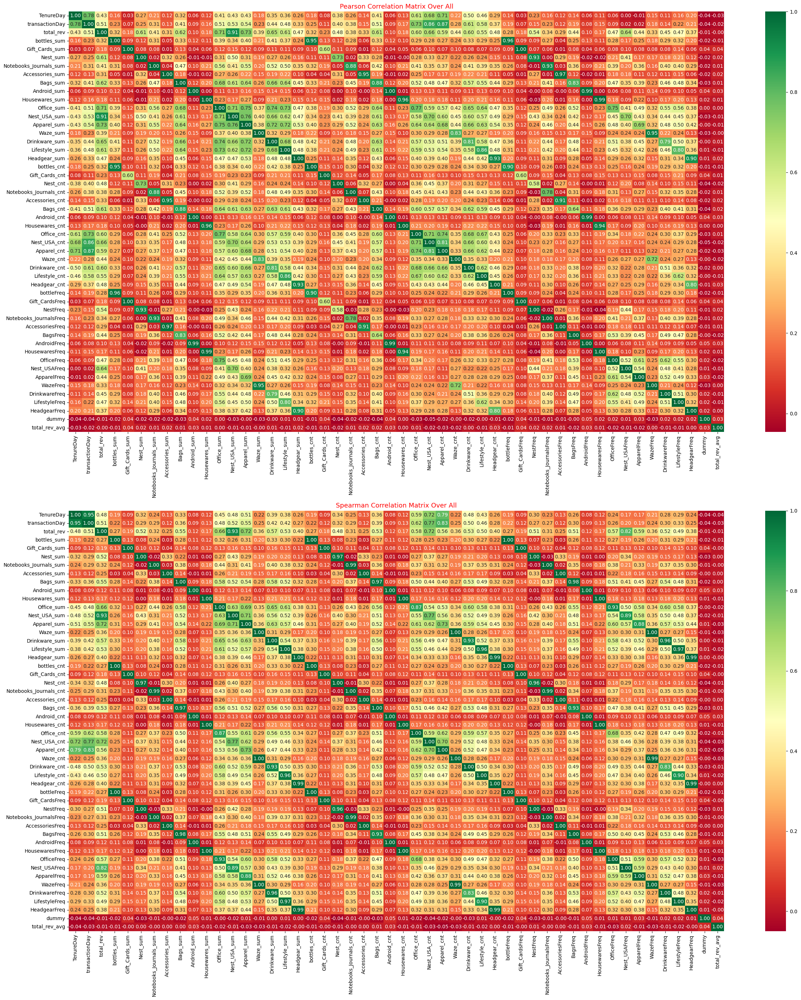

In [101]:
df_prd_num = df_prd.select_dtypes(include= 'number')
df_prd_num.dropna(inplace=True)

plt.figure(figsize = (25,28))

plt.subplot(2,1,1)
sns.heatmap(df_prd_num.corr(method='pearson'), annot = True, fmt=".2f", cmap='RdYlGn')
plt.title('Pearson Correlation Matrix Over All', color = 'r', size =13)

plt.subplot(2,1,2)
sns.heatmap(df_prd_num.corr(method='spearman'), annot = True, fmt=".2f", cmap='RdYlGn')
plt.title('Spearman Correlation Matrix Over All', color = 'r', size =13)

plt.tight_layout()
plt.show()

In [102]:
dummies_df = pd.get_dummies(df_prd[['Gender', 'Location']], drop_first=True, dtype=int)
dummy_df = pd.concat([df_prd,dummies_df], axis = 1)
dummy_df.head()

,CustomerID,Gender,Location,TenureDay,transactionDay,total_rev,bottles_sum,Gift_Cards_sum,Nest_sum,Notebooks_Journals_sum,Accessories_sum,Bags_sum,Android_sum,Housewares_sum,Office_sum,Nest_USA_sum,Apparel_sum,Waze_sum,Drinkware_sum,Lifestyle_sum,Headgear_sum,bottles_cnt,Gift_Cards_cnt,Nest_cnt,Notebooks_Journals_cnt,Accessories_cnt,Bags_cnt,Android_cnt,Housewares_cnt,Office_cnt,Nest_USA_cnt,Apparel_cnt,Waze_cnt,Drinkware_cnt,Lifestyle_cnt,Headgear_cnt,bottleFreq,Gift_CardsFreq,NestFreq,Notebooks_JournalsFreq,AccessoriesFreq,BagsFreq,AndroidFreq,HousewaresFreq,OfficeFreq,Nest_USAFreq,ApparelFreq,WazeFreq,DrinkwareFreq,LifestyleFreq,HeadgearFreq,dummy,total_rev_avg,Gender_M,Location_Chicago,Location_New Jersey,Location_New York,Location_Washington DC
0,12346,F,New York,0,1,-1463.06,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.000000,0.0,1.000000,0.0,0.0,0.0,0.0,52,35607.896786,0,0,0,1,0
1,12347,M,New York,223,3,113373.30,0,0,2,0,1,2,0,0,7,16,8,0,1,1,1,0,0,1,0,1,1,0,0,3,2,3,0,1,1,1,0.0,0.0,2.0,0.0,1.0,2.0,0.0,0.0,2.333333,8.0,2.666667,0.0,1.0,1.0,1.0,27,38612.817750,1,0,0,1,0
2,12348,M,California,119,2,10017.30,0,0,0,0,0,2,0,0,3,2,3,0,3,1,0,0,0,0,0,0,2,0,0,2,2,2,0,2,1,0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.500000,1.0,1.500000,0.0,1.5,1.0,0.0,86,54437.957556,1,0,0,0,0
3,12350,M,California,0,1,10248.80,0,0,0,0,0,0,0,0,0,5,4,0,0,0,2,0,0,0,0,0,0,0,0,0,1,1,0,0,0,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,5.0,4.000000,0.0,0.0,0.0,2.0,93,54437.957556,1,0,0,0,0
4,12356,F,Chicago,0,1,4911.19,0,0,2,0,0,1,0,0,1,4,6,0,2,1,0,0,0,1,0,0,1,0,0,1,1,1,0,1,1,0,0.0,0.0,2.0,0.0,0.0,1.0,0.0,0.0,1.000000,4.0,6.000000,0.0,2.0,1.0,0.0,80,56143.293765,0,1,0,0,0


In [103]:
x = dummy_df.drop(columns = ['total_rev','Gender','Location','CustomerID'], axis = 1)
y = pd.DataFrame(dummy_df['total_rev'])

In [104]:
x

,TenureDay,transactionDay,bottles_sum,Gift_Cards_sum,Nest_sum,Notebooks_Journals_sum,Accessories_sum,Bags_sum,Android_sum,Housewares_sum,Office_sum,Nest_USA_sum,Apparel_sum,Waze_sum,Drinkware_sum,Lifestyle_sum,Headgear_sum,bottles_cnt,Gift_Cards_cnt,Nest_cnt,Notebooks_Journals_cnt,Accessories_cnt,Bags_cnt,Android_cnt,Housewares_cnt,Office_cnt,Nest_USA_cnt,Apparel_cnt,Waze_cnt,Drinkware_cnt,Lifestyle_cnt,Headgear_cnt,bottleFreq,Gift_CardsFreq,NestFreq,Notebooks_JournalsFreq,AccessoriesFreq,BagsFreq,AndroidFreq,HousewaresFreq,OfficeFreq,Nest_USAFreq,ApparelFreq,WazeFreq,DrinkwareFreq,LifestyleFreq,HeadgearFreq,dummy,total_rev_avg,Gender_M,Location_Chicago,Location_New Jersey,Location_New York,Location_Washington DC
0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.000000,0.0,1.000000,0.0,0.0,0.0,0.0,52,35607.896786,0,0,0,1,0
1,223,3,0,0,2,0,1,2,0,0,7,16,8,0,1,1,1,0,0,1,0,1,1,0,0,3,2,3,0,1,1,1,0.0,0.0,2.0,0.0,1.0,2.0,0.0,0.0,2.333333,8.0,2.666667,0.0,1.0,1.0,1.0,27,38612.817750,1,0,0,1,0
2,119,2,0,0,0,0,0,2,0,0,3,2,3,0,3,1,0,0,0,0,0,0,2,0,0,2,2,2,0,2,1,0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.500000,1.0,1.500000,0.0,1.5,1.0,0.0,86,54437.957556,1,0,0,0,0
3,0,1,0,0,0,0,0,0,0,0,0,5,4,0,0,0,2,0,0,0,0,0,0,0,0,0,1,1,0,0,0,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,5.0,4.000000,0.0,0.0,0.0,2.0,93,54437.957556,1,0,0,0,0
4,0,1,0,0,2,0,0,1,0,0,1,4,6,0,2,1,0,0,0,1,0,0,1,0,0,1,1,1,0,1,1,0,0.0,0.0,2.0,0.0,0.0,1.0,0.0,0.0,1.000000,4.0,6.000000,0.0,2.0,1.0,0.0,80,56143.293765,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1443,0,1,0,0,0,1,0,0,0,0,0,0,1,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,1,0,0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.000000,0.0,1.000000,0.0,1.0,0.0,0.0,71,42369.905366,0,0,0,0,0
1444,105,3,1,0,0,3,1,1,0,0,3,4,10,1,2,0,2,1,0,0,1,1,1,0,0,2,2,2,1,2,0,1,1.0,0.0,0.0,3.0,1.0,1.0,0.0,0.0,1.500000,2.0,5.000000,1.0,1.0,0.0,2.0,18,38612.817750,1,0,0,1,0
1445,76,2,0,0,0,0,0,0,0,0,1,0,2,0,0,0,0,0,0,0,0,0,0,0,0,1,0,2,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.000000,0.0,1.000000,0.0,0.0,0.0,0.0,5,41963.292308,1,1,0,0,0
1446,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,1.0,0.000000,0.0,0.0,0.0,0.0,9,56143.293765,0,1,0,0,0


In [105]:
y

,total_rev
0,-1463.06
1,113373.30
2,10017.30
3,10248.80
4,4911.19
...,...
1443,2152.44
1444,13234.44
1445,313.17
1446,2884.20


In [106]:
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.30, random_state=42)

## Linear Regression

Test R2 Score: 0.891
Train R² Score: 0.883
Mean Absolute Error: 4810.729
Mean Squared Error: 62552505.741
Root Mean Squared Error: 7909.014
Cross-Validation R² Scores: [0.90376861 0.89267173 0.87817052 0.81799307 0.86355213 0.84548202
 0.82865985 0.8574939  0.79439085 0.84023142]
Average Cross-Validation R² Score: 0.852


<Figure size 1200x800 with 0 Axes>

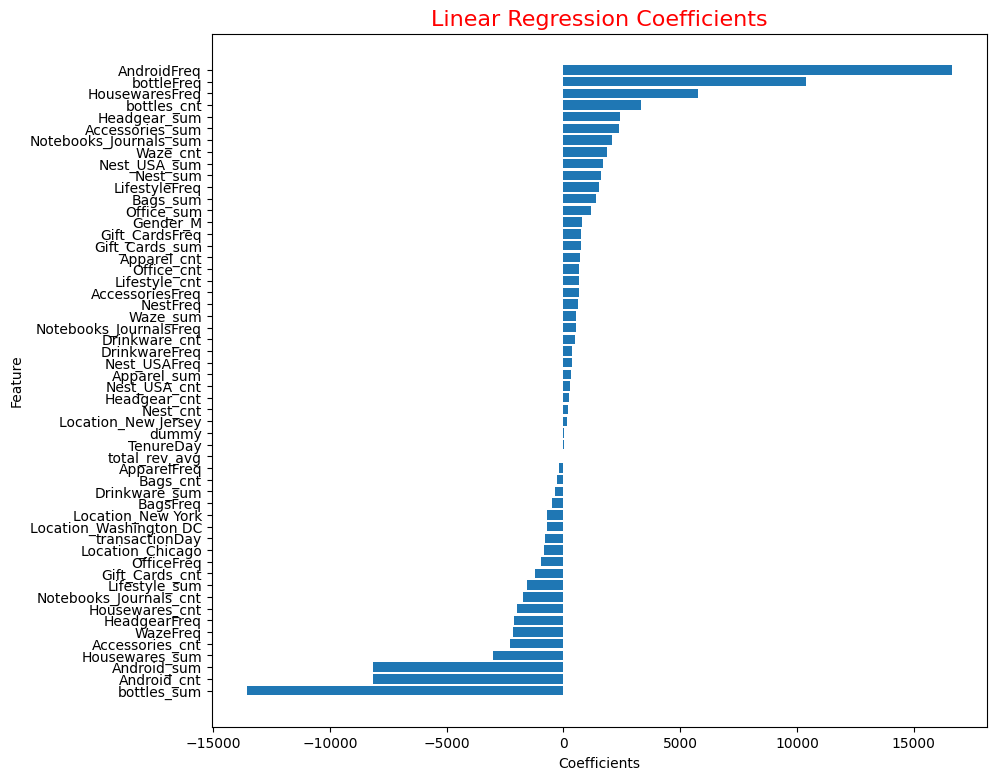

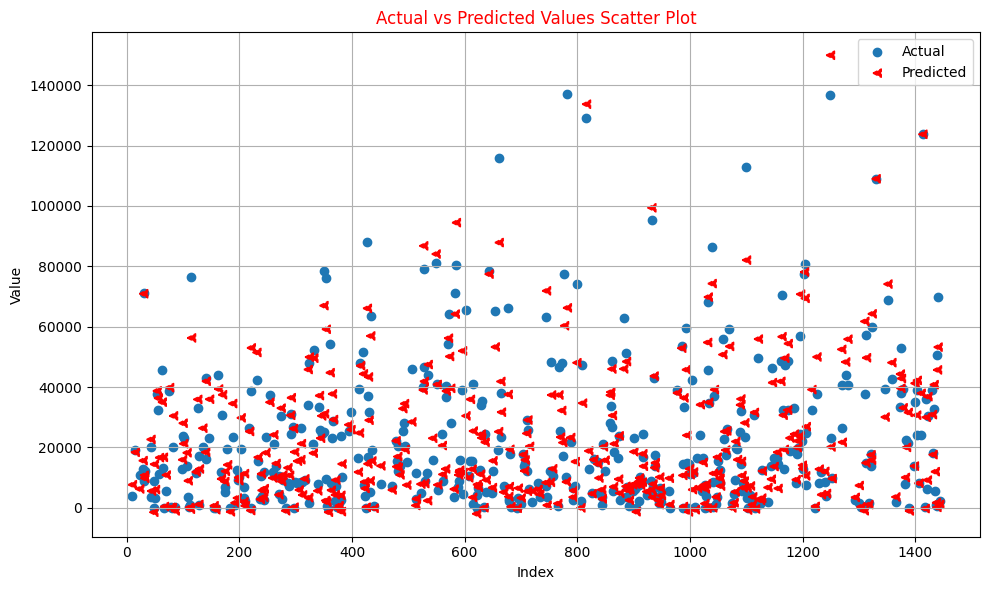

In [107]:
linear_reg(X_train, y_train)

## Random Forest Regressor

In [108]:
random_forest_reg(X_train, y_train)

c:\Users\w11\anaconda3\envs\mlflow\Lib\site-packages\sklearn\base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)
c:\Users\w11\anaconda3\envs\mlflow\Lib\site-packages\sklearn\base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)
c:\Users\w11\anaconda3\envs\mlflow\Lib\site-packages\sklearn\base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)
c:\Users\w11\anaconda3\envs\mlflow\Lib\site-packages\sklearn\base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please ch

Test R2 Score: 0.883
Mean Squared Error: 67603083.959
Root Mean Squared Error: 8222.109
R2 Scores:  [0.82417305 0.83412464 0.88327829 0.90482195 0.85710947]
Average R2 Scores:  0.8607014794212924


## XGBOOST Regressor

In [109]:
xgb_regressor(X_train, y_train)

c:\Users\w11\anaconda3\envs\mlflow\Lib\site-packages\xgboost\core.py:158: UserWarning: [11:27:20] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "colsample_bytree", "max_depth" } are not used.

  warnings.warn(smsg, UserWarning)
c:\Users\w11\anaconda3\envs\mlflow\Lib\site-packages\xgboost\core.py:158: UserWarning: [11:27:22] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "colsample_bytree", "max_depth" } are not used.

  warnings.warn(smsg, UserWarning)
c:\Users\w11\anaconda3\envs\mlflow\Lib\site-packages\xgboost\core.py:158: UserWarning: [11:27:24] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "colsample_bytree", "max_depth" } are not used.

  warnings.w

Test R2 Score: 0.892
Train R² Score: 0.866
Mean Absolute Error: 4815.240
Mean Squared Error: 62178427.077
Root Mean Squared Error: 7885.330
R2 Scores:  [0.8331846  0.85752147 0.87546206 0.91434115 0.87758762]
Average R2 Scores from cross validation:  0.8716193795204162


In [110]:

polynomal_reg(X_train, y_train)


Test R2 Score: 0.891
Train R² Score: 0.883
Mean Absolute Error: 4810.729
Mean Squared Error: 62552505.741
Root Mean Squared Error: 7909.014
Cross-Validation R² Scores: [0.90376861 0.89267173 0.87817052 0.81799307 0.86355213 0.84548202
 0.82865985 0.8574939  0.79439085 0.84023142]
Average Cross-Validation R² Score: 0.852


c:\Users\w11\anaconda3\envs\mlflow\Lib\site-packages\sklearn\base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)
c:\Users\w11\anaconda3\envs\mlflow\Lib\site-packages\xgboost\core.py:158: UserWarning: [11:27:53] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "colsample_bytree", "max_depth" } are not used.

  warnings.warn(smsg, UserWarning)


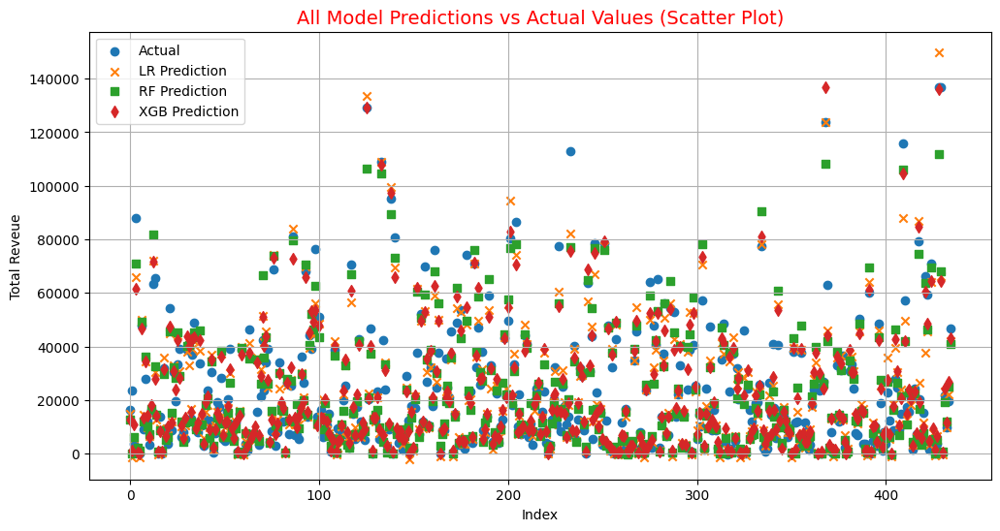

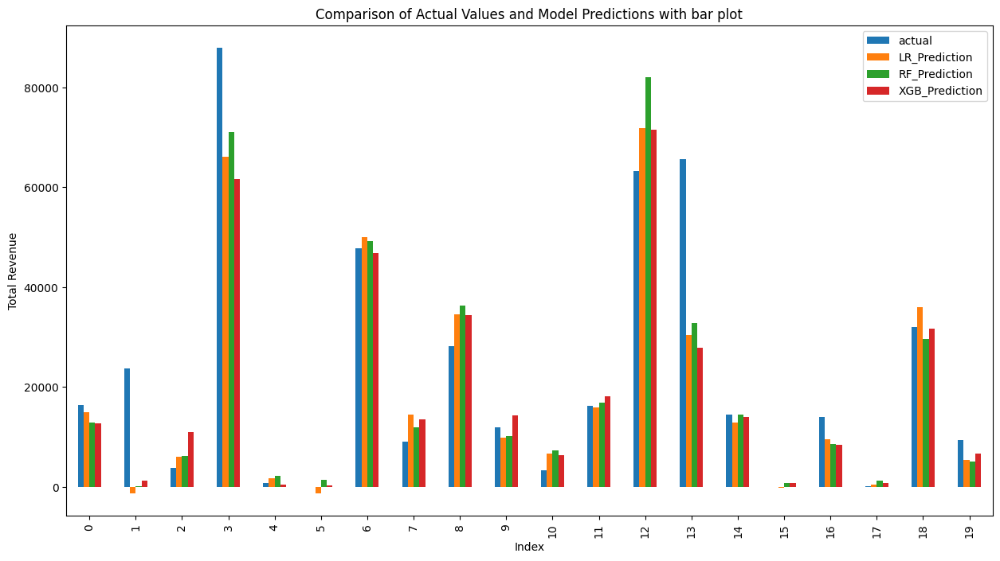

--- All Model Mean predictions-----
actual            22460.320529
LR_Prediction     22156.716426
RF_Prediction     22221.769429
XGB_Prediction    22460.572266
dtype: float64


In [111]:
combine_pred(X_train, X_test, y_train, y_test)

c:\Users\w11\anaconda3\envs\mlflow\Lib\site-packages\xgboost\core.py:158: UserWarning: [11:32:13] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "colsample_bytree", "max_depth" } are not used.

  warnings.warn(smsg, UserWarning)


                   Feature  Importance
11            Nest_USA_sum    0.411188
4                 Nest_sum    0.348802
10              Office_sum    0.133096
12             Apparel_sum    0.066756
41            Nest_USAFreq    0.036176
0                TenureDay    0.002771
47                   dummy    0.001208
48           total_rev_avg    0.000003
34                NestFreq    0.000000
40              OfficeFreq    0.000000
33          Gift_CardsFreq    0.000000
32              bottleFreq    0.000000
31            Headgear_cnt    0.000000
36         AccessoriesFreq    0.000000
37                BagsFreq    0.000000
38             AndroidFreq    0.000000
39          HousewaresFreq    0.000000
35  Notebooks_JournalsFreq    0.000000
44           DrinkwareFreq    0.000000
42             ApparelFreq    0.000000
43                WazeFreq    0.000000
29           Drinkware_cnt    0.000000
45           LifestyleFreq    0.000000
46            HeadgearFreq    0.000000
49                Gender_

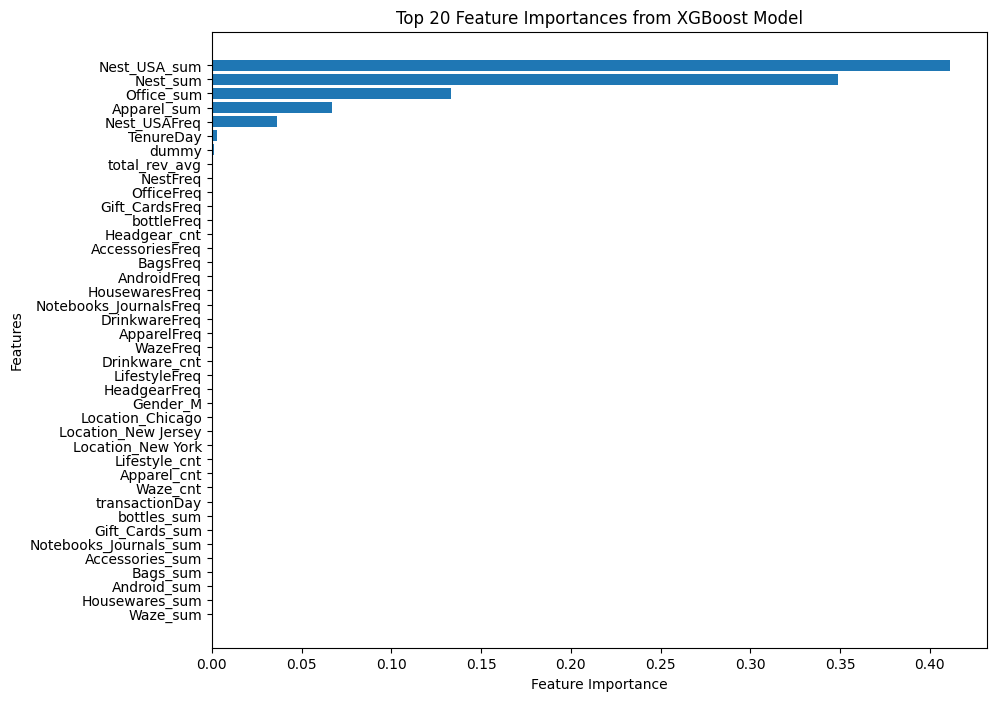

In [113]:
xg_reg = xgb.XGBRegressor(objective='reg:squarederror', colsample_bytree=0.7, learning_rate=0.1,
                        max_depth=10, alpha=2000, n_estimators=2000, booster = 'gblinear' , eval_metric = ['rmse','mae'])
xg_reg.fit(X_train, y_train)
importances = xg_reg.feature_importances_

# DataFrame olarak sıralı hale getir
importance_df = pd.DataFrame({
    'Feature': X_train.columns,
    'Importance': importances
})

# En yüksek önem düzeyine sahip 20 özelliği sırala
top_20_features = importance_df.sort_values(by='Importance', ascending=False).head(40)

# Sonuçları yazdır
print(top_20_features)

# Görselleştirme
plt.figure(figsize=(10, 8))
plt.barh(top_20_features['Feature'], top_20_features['Importance'])
plt.xlabel("Feature Importance")
plt.ylabel("Features")
plt.title("Top 20 Feature Importances from XGBoost Model")
plt.gca().invert_yaxis()  # En önemli özellik en üstte olacak şekilde ters çevirir
plt.show()


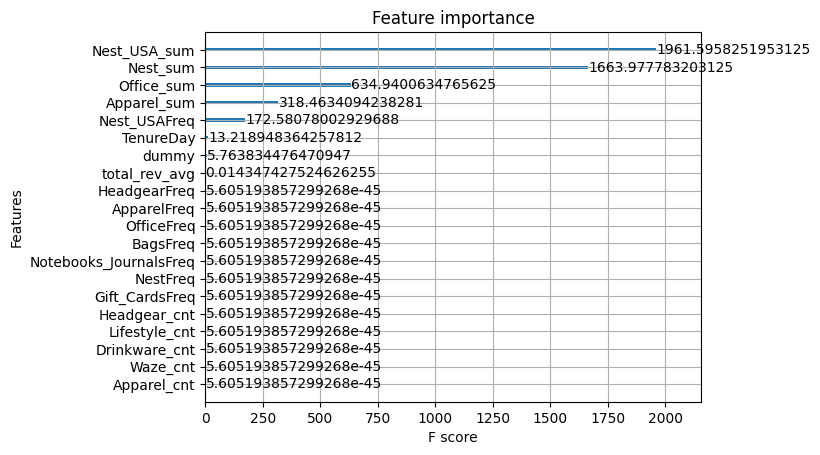

In [114]:
xgb.plot_importance(xg_reg, max_num_features=20)
plt.show()

In [ ]:
## XGBOOST GridSearchCV 
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.30, random_state=42)
def xgb_model_output_regressor(X_train, y_train, X_test, y_test):
    param_grid = {
        'n_estimators': [50, 100, 150, 500, 1000],
        'learning_rate': [0.01, 0.1, 0.2],
        'max_depth': [3, 5, 7,10],
        'gamma': [0, 0.1, 0.2],
        'reg_alpha': [0, 0.1],
        'reg_lambda': [1, 2],
        'colsample_bytree' : [0.1, 0.5, 0.7],
        'alpha': [250, 1000, 2000],
        'booster' : ['gblinear','gbtree'],
        'eval_metric' : ['rmse','mae']
    }
    

    xgb_reg = xgb.XGBRegressor()
    grid_search = GridSearchCV(xgb_reg, param_grid, cv=5, scoring='neg_mean_squared_error', verbose=1)
    
    # Fit GridSearchCV model
    grid_search.fit(X_train, y_train)
    
    # Best parameters and best score
    print("Best Params:", grid_search.best_params_)
    print("Best RMSE Score (neg):", np.sqrt(-grid_search.best_score_))
    
    # Retrain model with best parameters on the entire training data
    best_params = grid_search.best_params_
    xgb_best_reg = XGBRegressor(**best_params)
    xgb_best_reg.fit(X_train, y_train)
    
    # Predict for test using the best model
    y_pred_xgb_best = xgb_best_reg.predict(X_test)
    
    # Evaluation Metrics
    rmse_xgb_best = np.sqrt(mean_squared_error(y_test, y_pred_xgb_best))
    mae_xgb_best = mean_absolute_error(y_test, y_pred_xgb_best)
    r2_xgb_best = r2_score(y_test, y_pred_xgb_best)
    
    print(f'XGB Best Model RMSE: {rmse_xgb_best}')
    print(f'XGB Best Model MAE: {mae_xgb_best}')
    print(f'XGB Best Model R²: {r2_xgb_best}')
    
    # Plot predictions vs true values
    plt.figure(figsize=(8, 6))
    plt.scatter(y_test, y_pred_xgb_best, alpha=0.6)
    plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], color='red')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.title('True vs Predicted Values for XGBoost Regressor')
    plt.show()
    
    return xgb_best_reg, rmse_xgb_best, mae_xgb_best, r2_xgb_best

# Example of using the function:
xgb_model_output_regressor(X_train, y_train, X_test, y_test)

Fitting 5 folds for each of 25920 candidates, totalling 129600 fits


c:\Users\w11\anaconda3\envs\mlflow\Lib\site-packages\xgboost\core.py:158: UserWarning: [11:44:41] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "colsample_bytree", "gamma", "max_depth" } are not used.

  warnings.warn(smsg, UserWarning)
c:\Users\w11\anaconda3\envs\mlflow\Lib\site-packages\xgboost\core.py:158: UserWarning: [11:44:41] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "colsample_bytree", "gamma", "max_depth" } are not used.

  warnings.warn(smsg, UserWarning)
c:\Users\w11\anaconda3\envs\mlflow\Lib\site-packages\xgboost\core.py:158: UserWarning: [11:44:41] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "colsample_bytree", "gamma", "max_depth" } 